# Importing dataset and dependencies

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path="/content/drive/MyDrive/messages.csv"

In [ ]:
from IPython.display import clear_output
import numpy as np
import pandas as pd
df=pd.read_csv(path)
clear_output()

In [ ]:
df

,_id,text,direction,type,createdAt
0,ObjectId(614c4f96bb6525563130cebd),Ok,INBOUND,TEXT,2021-09-23T09:57:42.433Z
1,ObjectId(614c4fa1bb6525563130cebf),hi,INBOUND,TEXT,2021-09-23T09:57:53.317Z
2,ObjectId(614c4fa4bb6525563130cec0),"Hi Satvik, I am Myra, your Concierge AI Assist...",OUTBOUND,TEXT,2021-09-23T09:57:56.066Z
3,ObjectId(614c4fa5bb6525563130cec2),NaN,INBOUND,IMAGE,2021-09-23T09:57:57.496Z
4,ObjectId(614c4fb3bb6525563130cec3),1,INBOUND,TEXT,2021-09-23T09:58:11.431Z
...,...,...,...,...,...
1739749,ObjectId(63be6c1aa51a3e6365f886a9),Thanks for your message. Will get back to you ...,INBOUND,TEXT,2023-01-11T07:58:18.446Z
1739750,ObjectId(63be6c1ba51a3e6365f886aa),I didn't get what you said. I am still learnin...,OUTBOUND,TEXT,2023-01-11T07:58:19.562Z
1739751,ObjectId(63be6c1ba51a3e6365f886ab),Anytime. That's what I'm here for.,OUTBOUND,TEXT,2023-01-11T07:58:19.734Z
1739752,ObjectId(63be6c5aa51a3e6365f886ad),NaN,INBOUND,DOCUMENT,2023-01-11T07:59:22.335Z


# Preprocessing

Selecting rows with direction = 'INBOUND'

In [ ]:
df1=df.loc[df['direction']=='INBOUND']

Selecting rows with type = 'TEXT

In [ ]:
df2=df1.loc[df1['type']=='TEXT']

Checking for null values

In [ ]:
df2.isnull().sum()

_id          0
text         8
direction    0
type         0
createdAt    0
dtype: int64

Dropping null values

In [ ]:
df2 = df2.dropna(how='any',axis=0) 

In [ ]:
df2.head()

,_id,text,direction,type,createdAt
0,ObjectId(614c4f96bb6525563130cebd),Ok,INBOUND,TEXT,2021-09-23T09:57:42.433Z
1,ObjectId(614c4fa1bb6525563130cebf),hi,INBOUND,TEXT,2021-09-23T09:57:53.317Z
4,ObjectId(614c4fb3bb6525563130cec3),1,INBOUND,TEXT,2021-09-23T09:58:11.431Z
6,ObjectId(614c4fe5bb6525563130cec6),Hello Myra!,INBOUND,TEXT,2021-09-23T09:59:01.814Z
8,ObjectId(614c4ff1bb6525563130cec9),Did get the discount on food 25,INBOUND,TEXT,2021-09-23T09:59:13.297Z


Selecting rows with words more than 5 in text col

In [ ]:
df2=df2[df2['text'].str.split().str.len() > 5]

In [ ]:
df2

,_id,text,direction,type,createdAt
8,ObjectId(614c4ff1bb6525563130cec9),Did get the discount on food 25,INBOUND,TEXT,2021-09-23T09:59:13.297Z
9,ObjectId(614c502dbb6525563130cecb),Non veg buffet price for 1 member?,INBOUND,TEXT,2021-09-23T10:00:13.683Z
16,ObjectId(614c5081bb6525563130ced6),I did make the reservation. There is no bill b...,INBOUND,TEXT,2021-09-23T10:01:37.314Z
26,ObjectId(614c5139bb6525563130cee2),Sorry it was a booking by mistake,INBOUND,TEXT,2021-09-23T10:04:41.898Z
37,ObjectId(614c544bbb6525563130ceef),How much is the buffet per person?,INBOUND,TEXT,2021-09-23T10:17:47.868Z
...,...,...,...,...,...
1739731,ObjectId(63be6992a51a3e6365f88696),"Despite having the membership, your services a...",INBOUND,TEXT,2023-01-11T07:47:30.546Z
1739735,ObjectId(63be69e0a51a3e6365f8869a),Please give me a deal today for Burma Burma Se...,INBOUND,TEXT,2023-01-11T07:48:48.704Z
1739746,ObjectId(63be6b67a51a3e6365f886a5),Thank you for your message. This Contact numbe...,INBOUND,TEXT,2023-01-11T07:55:19.934Z
1739748,ObjectId(63be6c1aa51a3e6365f886a8),"Thank you for your message.if i don't respond,...",INBOUND,TEXT,2023-01-11T07:58:18.412Z


## Find Duplicate rows and drop them

In [ ]:
duplicate_rows = df2[df2.duplicated(['text'])]

In [ ]:
len(duplicate_rows)

445630

In [ ]:
duplicate_rows = duplicate_rows.drop_duplicates(subset=['text'])
print(len(duplicate_rows))
print(duplicate_rows['text'])

8722
184                                 Will be there in 15 mins
211        Thank you for contacting Kanak Interiors! Plea...
1371       Welcome to VERANDAH MOONSHINE! Thanks for cont...
1524       Thank you for your message. We’re unavailable ...
2049       Dear Guest, \n\nThank you for your message, yo...
                                 ...                        
1739111    Thank you for contacting SOMENATH DHAR! Please...
1739127    Thank you for contacting Purrfect Touch! Pet g...
1739131    Thank you for contacting Horoscope Analyst Dee...
1739153    Thank you for contacting RENOVATING BODIES! Pl...
1739163    Thank you for contacting SREE SAI SV OPTICALS!...
Name: text, Length: 8722, dtype: object


In [ ]:
df2 = df2.drop_duplicates(subset=['text'])
df2

,_id,text,direction,type,createdAt
8,ObjectId(614c4ff1bb6525563130cec9),Did get the discount on food 25,INBOUND,TEXT,2021-09-23T09:59:13.297Z
9,ObjectId(614c502dbb6525563130cecb),Non veg buffet price for 1 member?,INBOUND,TEXT,2021-09-23T10:00:13.683Z
16,ObjectId(614c5081bb6525563130ced6),I did make the reservation. There is no bill b...,INBOUND,TEXT,2021-09-23T10:01:37.314Z
26,ObjectId(614c5139bb6525563130cee2),Sorry it was a booking by mistake,INBOUND,TEXT,2021-09-23T10:04:41.898Z
37,ObjectId(614c544bbb6525563130ceef),How much is the buffet per person?,INBOUND,TEXT,2021-09-23T10:17:47.868Z
...,...,...,...,...,...
1739721,ObjectId(63be6807a51a3e6365f88689),"January 11, 2023\nThangavel SP\nDepartment of ...",INBOUND,TEXT,2023-01-11T07:40:55.629Z
1739731,ObjectId(63be6992a51a3e6365f88696),"Despite having the membership, your services a...",INBOUND,TEXT,2023-01-11T07:47:30.546Z
1739735,ObjectId(63be69e0a51a3e6365f8869a),Please give me a deal today for Burma Burma Se...,INBOUND,TEXT,2023-01-11T07:48:48.704Z
1739748,ObjectId(63be6c1aa51a3e6365f886a8),"Thank you for your message.if i don't respond,...",INBOUND,TEXT,2023-01-11T07:58:18.412Z


## Reset Index

In [ ]:
df2.reset_index(drop=True, inplace=True)
df2

,_id,text,direction,type,createdAt
0,ObjectId(614c4ff1bb6525563130cec9),Did get the discount on food 25,INBOUND,TEXT,2021-09-23T09:59:13.297Z
1,ObjectId(614c502dbb6525563130cecb),Non veg buffet price for 1 member?,INBOUND,TEXT,2021-09-23T10:00:13.683Z
2,ObjectId(614c5081bb6525563130ced6),I did make the reservation. There is no bill b...,INBOUND,TEXT,2021-09-23T10:01:37.314Z
3,ObjectId(614c5139bb6525563130cee2),Sorry it was a booking by mistake,INBOUND,TEXT,2021-09-23T10:04:41.898Z
4,ObjectId(614c544bbb6525563130ceef),How much is the buffet per person?,INBOUND,TEXT,2021-09-23T10:17:47.868Z
...,...,...,...,...,...
77527,ObjectId(63be6807a51a3e6365f88689),"January 11, 2023\nThangavel SP\nDepartment of ...",INBOUND,TEXT,2023-01-11T07:40:55.629Z
77528,ObjectId(63be6992a51a3e6365f88696),"Despite having the membership, your services a...",INBOUND,TEXT,2023-01-11T07:47:30.546Z
77529,ObjectId(63be69e0a51a3e6365f8869a),Please give me a deal today for Burma Burma Se...,INBOUND,TEXT,2023-01-11T07:48:48.704Z
77530,ObjectId(63be6c1aa51a3e6365f886a8),"Thank you for your message.if i don't respond,...",INBOUND,TEXT,2023-01-11T07:58:18.412Z


In [ ]:
df99=df2

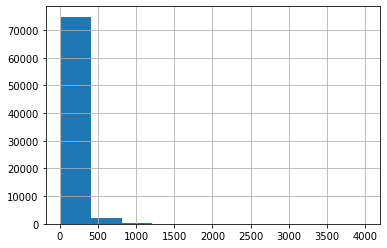

In [ ]:
df2['text'].str.len().hist()

# Frequency of words

In [ ]:
corpus=[]
new= df2['text'].str.split()
new=new.values.tolist()
corpus=[word for i in new for word in i]

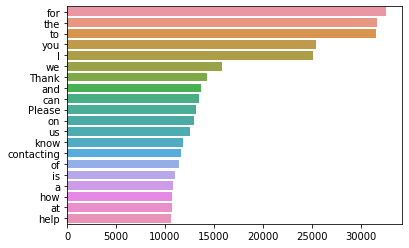

In [ ]:
import seaborn as sns
from collections import Counter
counter=Counter(corpus)
most=counter.most_common()

x, y= [], []
for word,count in most[:20]:
        x.append(word)
        y.append(count)

sns.barplot(x=y,y=x)

# Sentiment analysis

## Text Blob

In [ ]:
from textblob import TextBlob

def classify_sentiment(sentence):
    analysis = TextBlob(sentence)
    if analysis.sentiment.polarity > 0:
        return "positive"
    elif analysis.sentiment.polarity == 0:
        return "neutral"
    else:
        return "negative"

# Add a new column to the dataframe with the sentiment classification
df2["sentiment"] = df2["text"].apply(classify_sentiment)
clear_output()

In [ ]:
df2

,_id,text,direction,type,createdAt,sentiment
0,ObjectId(614c4ff1bb6525563130cec9),Did get the discount on food 25,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral
1,ObjectId(614c502dbb6525563130cecb),Non veg buffet price for 1 member?,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral
2,ObjectId(614c5081bb6525563130ced6),I did make the reservation. There is no bill b...,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral
3,ObjectId(614c5139bb6525563130cee2),Sorry it was a booking by mistake,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative
4,ObjectId(614c544bbb6525563130ceef),How much is the buffet per person?,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive
...,...,...,...,...,...,...
77527,ObjectId(63be6807a51a3e6365f88689),"January 11, 2023\nThangavel SP\nDepartment of ...",INBOUND,TEXT,2023-01-11T07:40:55.629Z,positive
77528,ObjectId(63be6992a51a3e6365f88696),"Despite having the membership, your services a...",INBOUND,TEXT,2023-01-11T07:47:30.546Z,negative
77529,ObjectId(63be69e0a51a3e6365f8869a),Please give me a deal today for Burma Burma Se...,INBOUND,TEXT,2023-01-11T07:48:48.704Z,neutral
77530,ObjectId(63be6c1aa51a3e6365f886a8),"Thank you for your message.if i don't respond,...",INBOUND,TEXT,2023-01-11T07:58:18.412Z,neutral


In [ ]:
df2[df2['sentiment']=='positive']['text'].count()

19415

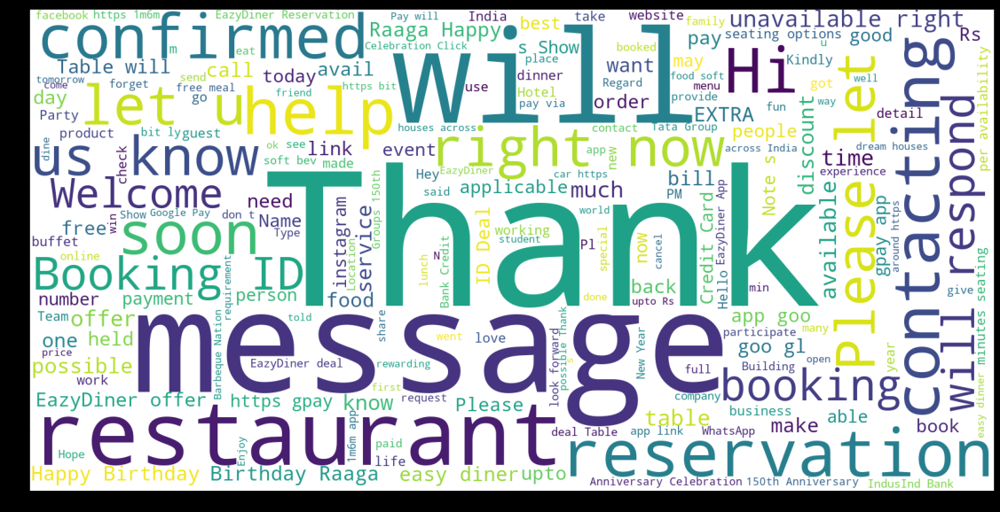

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df2[df2['sentiment']=='positive']['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

In [ ]:
df2[df2['sentiment']=='negative']['text'].count()

9098

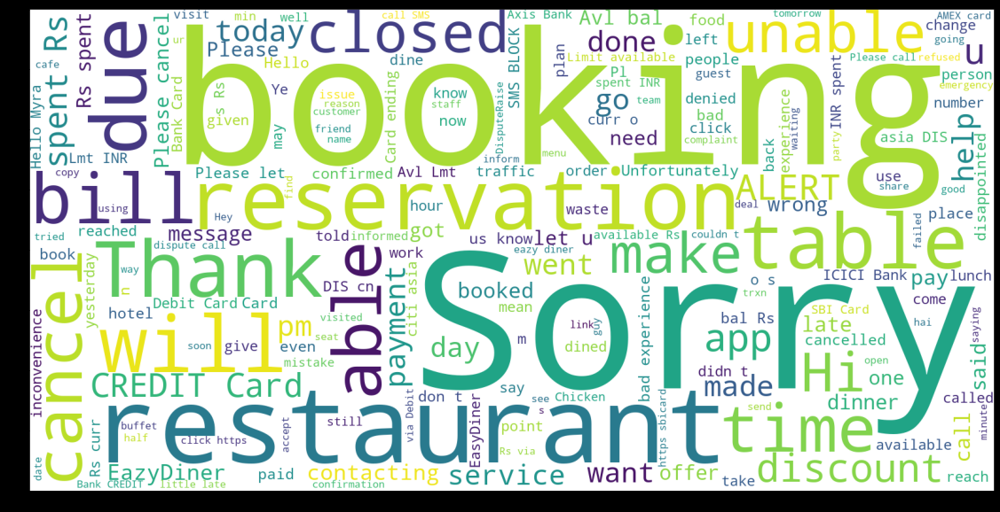

In [ ]:
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df2[df2['sentiment']=='negative']['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

In [ ]:
df2[df2['sentiment']=='neutral']['text'].count()

49019

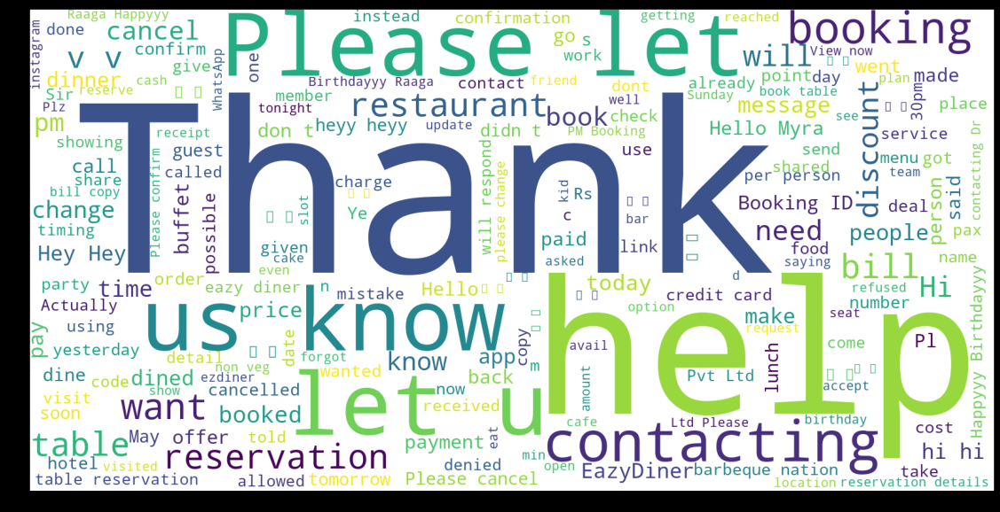

In [ ]:
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df2[df2['sentiment']=='neutral']['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

## Vader

In [ ]:
# !pip install vaderSentiment
# clear_output()

In [ ]:
# import pandas as pd
# from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# # create an instance of the SentimentIntensityAnalyzer
# analyzer = SentimentIntensityAnalyzer()

# # use the sentiment_intensity method on each sentence and store the result in a new column
# df2["sentiment_vader"] = df2["text"].apply(lambda x: analyzer.polarity_scores(x)["compound"])


# Named Entity Recognition

In [ ]:
# import spacy

# # Load the pre-trained NER model
# nlp = spacy.load("en_core_web_sm")

# # Define a function to extract entities from a sentence
# def extract_entities(sentence):
#     # Apply the NER model to the sentence
#     doc = nlp(sentence)
    
#     # Extract entities and their labels
#     entities = [(ent.text, ent.label_) for ent in doc.ents]
    
#     return entities

# # Apply the function to each sentence in the dataframe
# df2["entities"] = df2["text"].apply(extract_entities)


In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Flatten the list of entities and create a Pandas dataframe
# entities = [entity for entity_list in df2["entities"] for entity in entity_list]
# entities_df2 = pd.DataFrame(entities, columns=["Entity", "Label"])

# # Group the entities by label and count their occurrences
# grouped = entities_df2.groupby("Label").agg({"Entity": "count"}).reset_index()

# # Sort the data by the count of entities, in descending order
# grouped = grouped.sort_values("Entity", ascending=False)

# # Plot the count of only the top 5 entities by label using a bar chart
# sns.barplot(x="Label", y="Entity", data=grouped[:5])

# # Show the plot
# plt.show()


In [ ]:
# entities_df2

In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Flatten the list of entities and create a Pandas dataframe
# entities = [entity for entity_list in df2["entities"] for entity in entity_list]
# entities_df2 = pd.DataFrame(entities, columns=["Entity", "Label"])

# # Filter the data to include only entities of type PERSON
# entities_df = entities_df2[entities_df2["Label"] == "PERSON"]

# # Group the entities by label and count their occurrences
# grouped = entities_df.groupby("Label").agg({"Entity": "count"}).reset_index()

# # Sort the data by the count of entities, in descending order
# grouped = grouped.sort_values("Entity", ascending=False)

# # Plot the count of only the top 5 entities of type PERSON by label using a bar chart
# sns.barplot(x="Label", y="Entity", data=grouped[:5])

# # Show the plot
# plt.show()


In [ ]:
# import nltk
# import matplotlib.pyplot as plt

# # Flatten the list of entities and create a Pandas dataframe
# entities = [entity for entity_list in df2["entities"] for entity in entity_list]
# entities_df = pd.DataFrame(entities, columns=["Entity", "Label"])

# # Filter the data to include only entities of type PERSON
# entities_df = entities_df[entities_df["Label"] == "PERSON"]

# # Concatenate the entities into a single string
# entity_text = " ".join(entities_df["Entity"])

# # Tokenize the text into words
# tokens = nltk.word_tokenize(entity_text)

# # Convert the words to lowercase and remove stop words
# stop_words = nltk.corpus.stopwords.words("english")
# tokens = [word.lower() for word in tokens if word.lower() not in stop_words]

# # Plot the frequency distribution of the tokens using a bar chart
# fd = nltk.FreqDist(tokens)
# fd.plot(5, cumulative=False)

# # Show the plot
# plt.show()


In [ ]:
df2=df2.iloc[:1000,:]

# Porter Stemmer

In [ ]:
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
import re
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
port_stem = PorterStemmer()

In [ ]:
def stemming(content):
    stemmed_content = re.sub('[^a-zA-Z]',' ',content)
    stemmed_content = stemmed_content.lower()
    stemmed_content = stemmed_content.split()
    stemmed_content = [port_stem.stem(word) for word in stemmed_content if not word in stopwords.words('english')]
    stemmed_content = ' '.join(stemmed_content)
    return stemmed_content

In [ ]:
df2['text'] = df2['text'].apply(stemming)
clear_output()

Remove empty sentences in text

In [ ]:
df2['text'].replace('', np.nan, inplace=True)
clear_output()

In [ ]:
df2 = df2.dropna(how='any',axis=0) 

Remove all others types except str

In [ ]:
df2['text'] = df2['text'].str.replace('\d+', '')
clear_output()

In [ ]:
df2['text'].replace('', np.nan, inplace=True)

In [ ]:
df2 = df2.dropna(how='any',axis=0) 

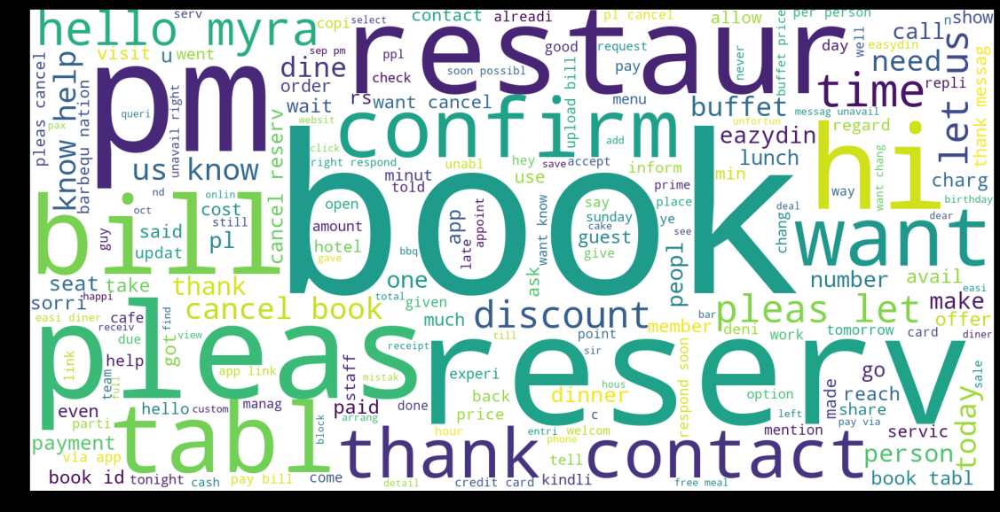

In [ ]:
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df2['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# 1) Using TF-IDF embeding

In [ ]:
df3=df2
df3.reset_index(drop=True, inplace=True)
df3

,_id,text,direction,type,createdAt,sentiment
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive
...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral


### Generate vectors

In [ ]:
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
TF_vectorizer = TfidfVectorizer()

In [ ]:
vectors_TF = TF_vectorizer.fit_transform(df3['text'])

In [ ]:

df3['vectors_TF'] = [vec.todense() for vec in vectors_TF]
df3


,_id,text,direction,type,createdAt,sentiment,vectors_TF
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]]


### Cosine similarity between each sentences

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
similarity_TF = cosine_similarity(vectors_TF)
similarity_TF

array([[1.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.26451607,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.26451607, ..., 0.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

### Clustering

In [ ]:
from sklearn.decomposition import PCA
reduced_vectors_TF = PCA(n_components=2).fit_transform(vectors_TF.toarray())

In [ ]:
k_rng=range(1,10)
sse=[]
for k in k_rng:
  km = KMeans(n_clusters=k)
  km.fit(reduced_vectors_TF)
  sse.append(km.inertia_)


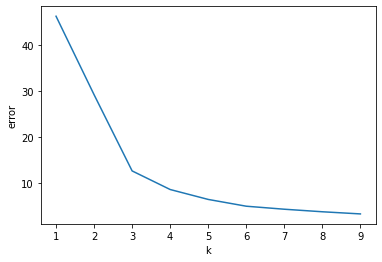

In [ ]:
from matplotlib import pyplot as plt
plt.xlabel('k')
plt.ylabel("error")
plt.plot(k_rng,sse)

In [ ]:
kmeans = KMeans(n_clusters=7, random_state=0).fit(reduced_vectors_TF)

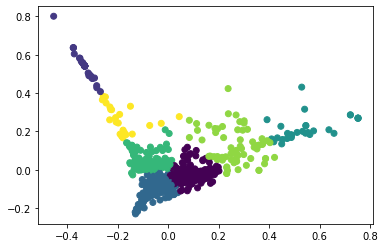

In [ ]:
# Plot the reduced vectors with different colors for each cluster
plt.scatter(reduced_vectors_TF[:, 0], reduced_vectors_TF[:, 1], c=kmeans.labels_)
plt.show()

In [ ]:
df3['cluster_TF'] = kmeans.predict(reduced_vectors_TF)

### Sentences which are similar to first sentence

In [ ]:
print(df3['text'][0])
print(0)
for i in range(len(df3)):
  similarity=cosine_similarity(vectors_TF[0],vectors_TF[i])
  if similarity>=0.5:
    print(df3['text'][i])
    print(i)

get discount food
0
get discount food
0
go get discount
318
get discount
365
book discount food soft bev given discount
857
book discount food soft bev given discount
910


## Clusters

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df3.groupby('cluster_TF').size()
print(result)

cluster_TF
0    204
1     37
2    507
3     33
4    121
5     72
6     23
dtype: int64


### Cluster : 0

In [ ]:
print(df3[df3['cluster_TF']==0]['text'])

3                               sorri book mistak
16                              charg advanc book
24            visit cancel plan proper sit arrang
30                      sorri plz cancel bymistak
32                               hi plz make book
                          ...                    
975                     possibl chang reserv time
976                                 book saturday
983                   pleas confirm book th octob
989                    get book person today even
990    barbecu nation would like book today guest
Name: text, Length: 204, dtype: object


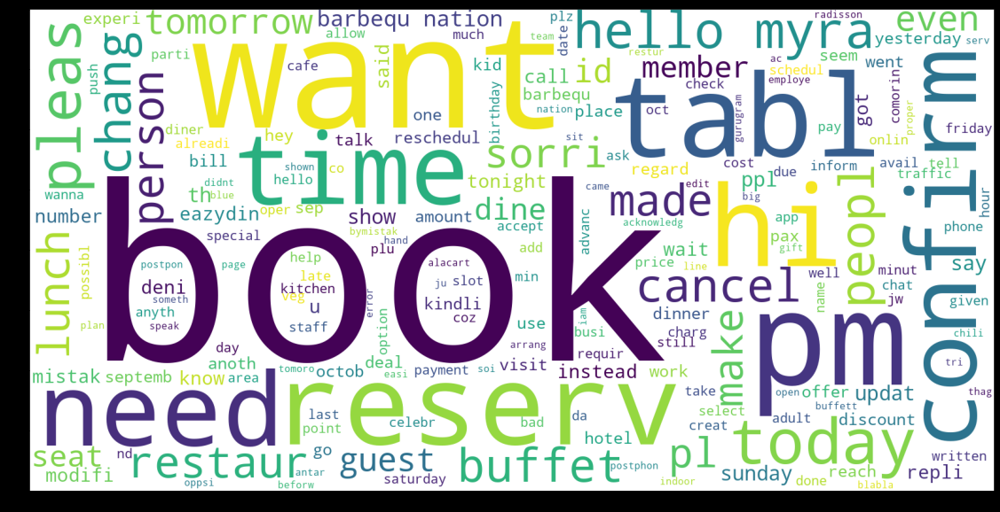

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==0]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df3[df3['cluster_TF']==1]['text'])

11     thank contact kanak interior pleas let us know...
17      thank contact benz packag pleas let us know help
22                  thank contact pleas let us know help
72     thank contact al mashriq fit pleas let us know...
77           thank contact medski pleas let us know help
105    thank contact aditya mathur pleas let us know ...
106    thank contact ministri booz pleas let us know ...
151    thank contact ala creation pleas let us know help
193    thank contact cut n sew fashion pleas let us k...
239           thank contact aarti pleas let us know help
252    thank contact kolkata mixtap pleas let us know...
275    thank contact thapa technic pleas let us know ...
283       thank contact shree bag pleas let us know help
297    thank contact renuka gurumurthi pleas let us k...
313    thank contact platform tech solut pleas let us...
353    thank contact us pleas let us know help khawso...
385    thank contact ak distribut india pix pleas let...
397    thank contact creativ cr

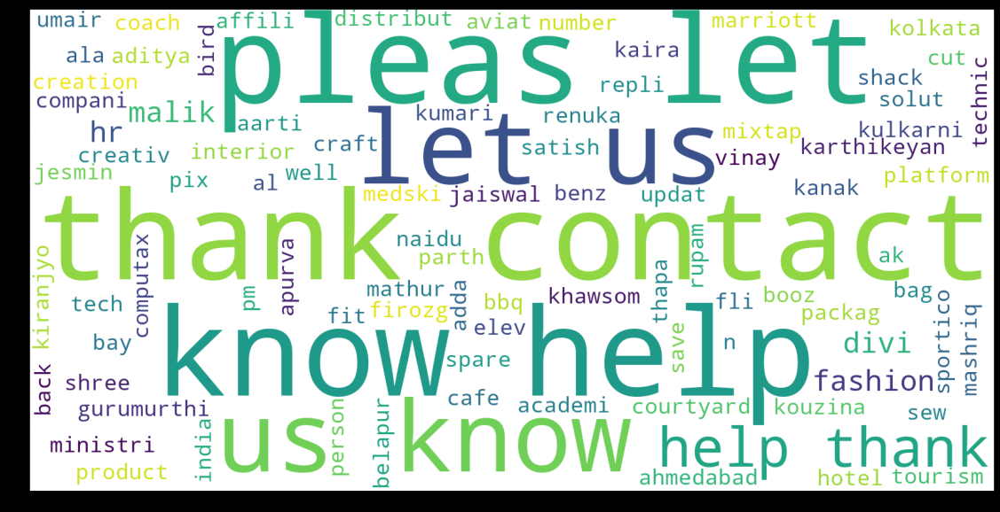

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==1]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df3[df3['cluster_TF']==2]['text'])

0                                      get discount food
1                            non veg buffet price member
2          make reserv bill bill present digit paid cash
4                                 much buffet per person
5      payment alert spent rs credit card xx radisson...
                             ...                        
988    two coupl need call daiblo reserv entri done e...
992                              arrang surpris birthday
993                            u arrang surpris birthday
995                   see time paid bill upload herewith
996                                     restaur page app
Name: text, Length: 507, dtype: object


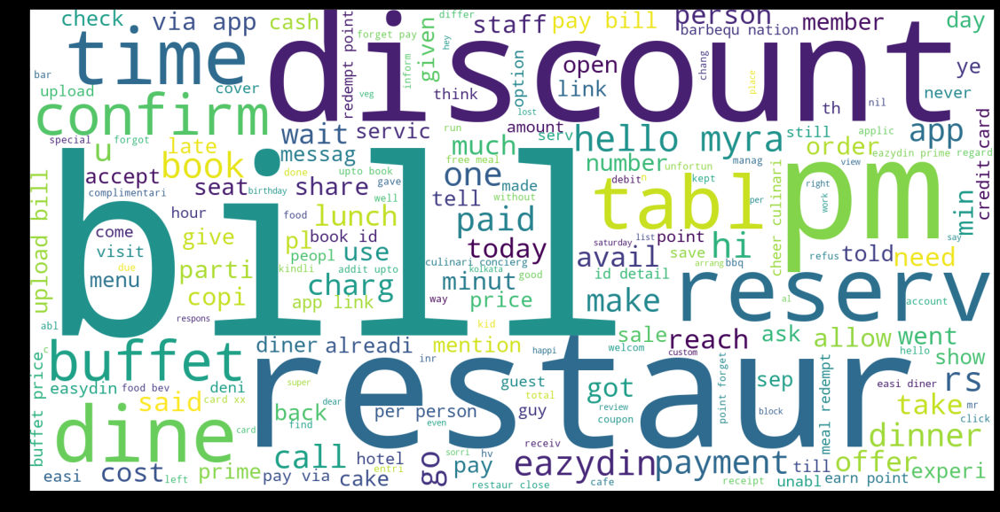

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==2]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df3[df3['cluster_TF']==3]['text'])

10                               want cancel book
39                         hi want cancel book pl
43                                  cancel reserv
50                    would like cancel book tabl
71                         hello want cancel book
78                            u pleas cancel book
81                         would like cancel book
199                           pl cancel tabl book
203                              want cancel book
245                        would like cancel book
286                        would like cancel book
314                              want cancel seat
315                              u pl cancel book
332                        sorri want cancel book
386                        would like cancel book
396               plan cancel pl cancel tabl book
419                              need cancel book
430                            want cancel reserv
457                             u ppl cancel book
485                        would like cancel book


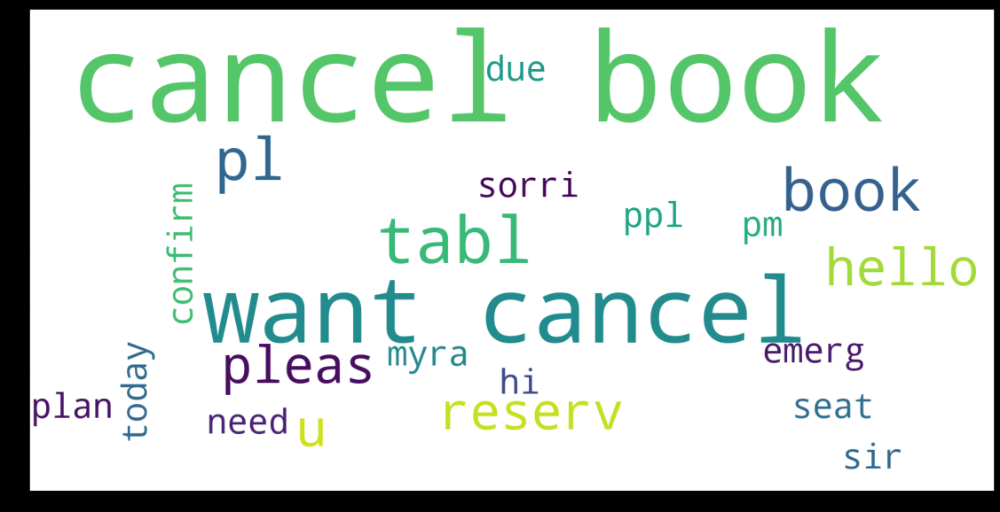

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==3]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df3[df3['cluster_TF']==4]['text'])

6                                          complain help
12                                may know non veg price
23       thank messag unavail right respond soon possibl
28                  pleas block ping reserv tonight full
37                            thank choos elit construct
                             ...                        
961                                 hi help chang reserv
981           hello myra mayb one person abl accommod us
984                    hello myra want know bill proceed
991    increas instagram follow peopl requir requir t...
994    hello dress code punjab grill pleas men wear s...
Name: text, Length: 121, dtype: object


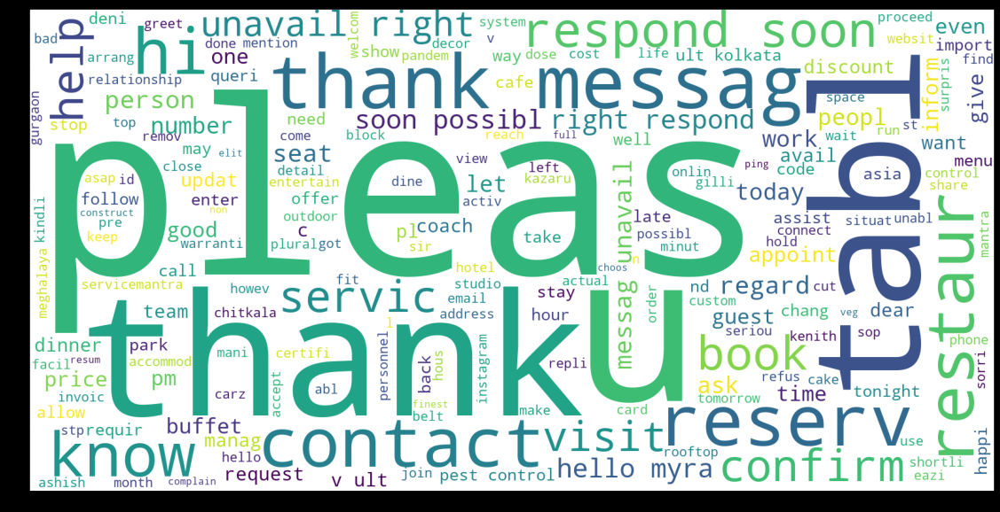

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==4]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df3[df3['cluster_TF']==5]['text'])

21                      would wish cancel tiqri
34                           alreadi msg cancel
44                            cancel websit app
52                  hi someth came cancel pleas
89            due person reson want cancel book
                         ...                   
964                          want pm unabl book
971                                 know cancel
972    cancel book number barbequ nation oct pm
982                          mistak cancel book
985                   sorri pleas cancel reserv
Name: text, Length: 72, dtype: object


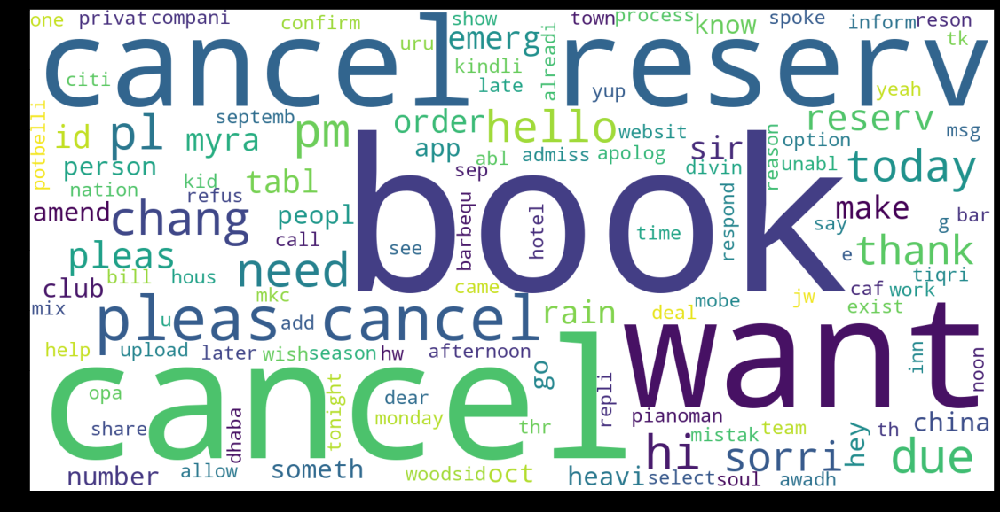

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==5]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 6

In [ ]:
print(df3[df3['cluster_TF']==6]['text'])

57     welcom verandah moonshin thank contact set vac...
64                     pleas let know reserv charg peopl
73                                                    us
82     thank contact www servicemantra pleas write us...
135    thank contact dom pizza member ddp pl let us k...
148    thank contact tutsin websit design digit marke...
211    thank pleas let know custom card contact numbe...
217    thank contact health lifestyl onlin educ consu...
342                       hotel allow us r say contact u
351    greet govindam retreat hope well thank contact...
352    dear sir madam namast thank contact momentt re...
359                                       contact number
473    thank contact sai shyam cater event first prio...
478    thank contact aarya nair pleas let us know hel...
489             pleas let know much need pay adult child
566     thank contact cafe chum bakk pleas allow us serv
714            pleas make book person pleas revert thank
768                        pl l

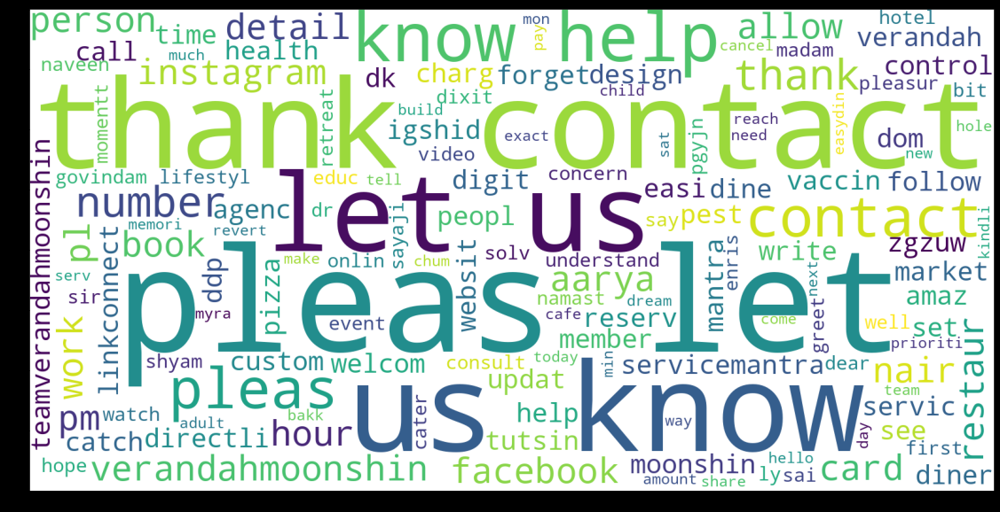

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df3[df3['cluster_TF']==6]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# 2) Using Word2vec embeding

In [ ]:
df4=df3
df4

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2
...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2


### Generating tokens

In [ ]:
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize

df4["tokens_word"] = df4["text"].apply(lambda x: word_tokenize(x))
clear_output()

### Generating vectors

In [ ]:
from gensim.models import Word2Vec

sentences = df4["tokens_word"].tolist()

# Train the Word2Vec model on the sentences
model = Word2Vec(sentences, min_count=1, size=100, window=5, workers=4)

# Use the trained model to create a vector representation of each sentence
df4["vectors_W2V"] = df4["tokens_word"].apply(lambda x: model.wv[x])

#Print the vector representation of the first sentence
#print(df4["vectors"][0])

In [ ]:
vectors_W2V = df4["vectors_W2V"].tolist()

In [ ]:
df4

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF,tokens_word,vectors_W2V
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[get, discount, food]","[[0.004462765, 0.00089486025, 0.001281267, 0.0..."
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[non, veg, buffet, price, member]","[[0.005131776, -0.004905238, -0.0015936384, 0...."
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[make, reserv, bill, bill, present, digit, pai...","[[-0.000308945, 0.0033469624, -0.0046594264, -..."
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0,"[sorri, book, mistak]","[[0.0019674986, 0.0011526848, -0.0016646305, 0..."
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[much, buffet, per, person]","[[0.00031941914, -0.00030237, 0.0012645756, 0...."
...,...,...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[arrang, surpris, birthday]","[[0.0021385285, 0.0024560557, -0.001455537, 0...."
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[u, arrang, surpris, birthday]","[[-0.0013370005, 0.0015429106, 0.00010546608, ..."
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4,"[hello, dress, code, punjab, grill, pleas, men...","[[0.00028019585, -0.00057927635, -0.0034817406..."
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[see, time, paid, bill, upload, herewith]","[[-0.0018154272, -0.0022914498, 0.0012173563, ..."


### Cosine Similarity

In [ ]:
import pandas as pd
import gensim
from sklearn.metrics.pairwise import cosine_similarity

sentences = df4["tokens_word"].tolist()

model = gensim.models.Word2Vec(sentences, size=100, window=5, min_count=1, workers=4)

vectors_W2V = []

for sentence in df4['text']:
    words = sentence.split()
    sentence_vector = [0 for _ in range(model.vector_size)]
    for word in words:
        if word in model.wv:
            sentence_vector += model.wv[word]
    sentence_vector /= len(words)
    vectors_W2V.append(sentence_vector)

cosine_similarities = cosine_similarity(vectors_W2V)
print(cosine_similarities)


[[1.         0.78138261 0.85021387 ... 0.71727819 0.81768182 0.80344472]
 [0.78138261 1.         0.75356174 ... 0.66146715 0.78100139 0.72335164]
 [0.85021387 0.75356174 1.         ... 0.71278194 0.88198762 0.76737101]
 ...
 [0.71727819 0.66146715 0.71278194 ... 1.         0.69551667 0.64845689]
 [0.81768182 0.78100139 0.88198762 ... 0.69551667 1.         0.79091847]
 [0.80344472 0.72335164 0.76737101 ... 0.64845689 0.79091847 1.        ]]


## Clustering

In [ ]:
import numpy as np
# converting aSDAE list to an array
vectors_W2V = np.array(vectors_W2V)

In [ ]:
from sklearn.decomposition import PCA
reduced_vectors_W2V = PCA(n_components=2).fit_transform(vectors_W2V)

In [ ]:
from sklearn.cluster import KMeans
k_rng=range(1,10)
sse=[]
for k in k_rng:
  km = KMeans(n_clusters=k)
  km.fit(reduced_vectors_W2V)
  sse.append(km.inertia_)

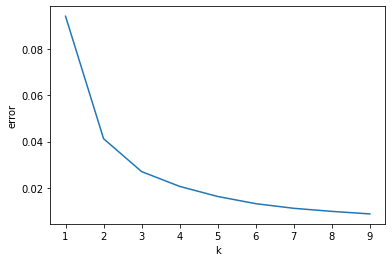

In [ ]:
from matplotlib import pyplot as plt
plt.xlabel('k')
plt.ylabel("error")
plt.plot(k_rng,sse)

In [ ]:
kmeans = KMeans(n_clusters=7)
clusters = kmeans.fit_predict(reduced_vectors_W2V)

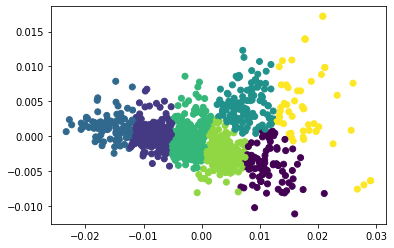

In [ ]:
# Plot the reduced vectors with different colors for each cluster
plt.scatter(reduced_vectors_W2V[:, 0], reduced_vectors_W2V[:, 1], c=kmeans.labels_)
plt.show()

In [ ]:
df4['cluster_W2V'] = kmeans.predict(reduced_vectors_W2V)

### Sentences which are similar to first sentence

In [ ]:
x=0
print(df4['text'][x])
print(x)
vec1 = vectors_W2V[x].reshape(1, -1)

for i in range(len(df3)):
  vec2 = vectors_W2V[i].reshape(1, -1)
  similarity=cosine_similarity(vec1,vec2)
  if similarity>=0.95:
    print(df4['text'][i])
    print(similarity)
    print(i)

get discount food
0
get discount food
[[1.]]
0
get discount
[[0.96889447]]
365


## Clusters

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df4.groupby('cluster_W2V').size()
print(result)

cluster_W2V
0     88
1    192
2     96
3    121
4    242
5    204
6     54
dtype: int64


### Cluster : 0

In [ ]:
print(df4[df4['cluster_W2V']==0]['text'])

0                         get discount food
22     thank contact pleas let us know help
42                                 get back
61                       hi updat book time
64        pleas let know reserv charg peopl
                       ...                 
949       pleas share number contact person
977                               bill dine
980             show pm reserv time account
983             pleas confirm book th octob
996                        restaur page app
Name: text, Length: 88, dtype: object


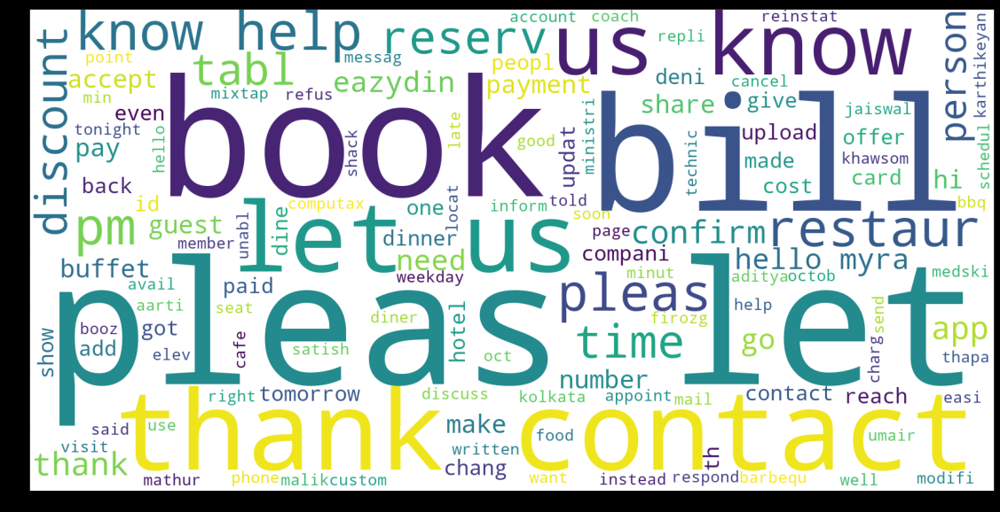

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==0]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df4[df4['cluster_W2V']==1]['text'])

5      payment alert spent rs credit card xx radisson...
6                                          complain help
24                   visit cancel plan proper sit arrang
29                              way might get littl late
31     food good look resist head art dum rang indulg...
                             ...                        
973                       said wait list delhi club hous
987    tata group th anniversari celebr click link pa...
991    increas instagram follow peopl requir requir t...
993                            u arrang surpris birthday
994    hello dress code punjab grill pleas men wear s...
Name: text, Length: 192, dtype: object


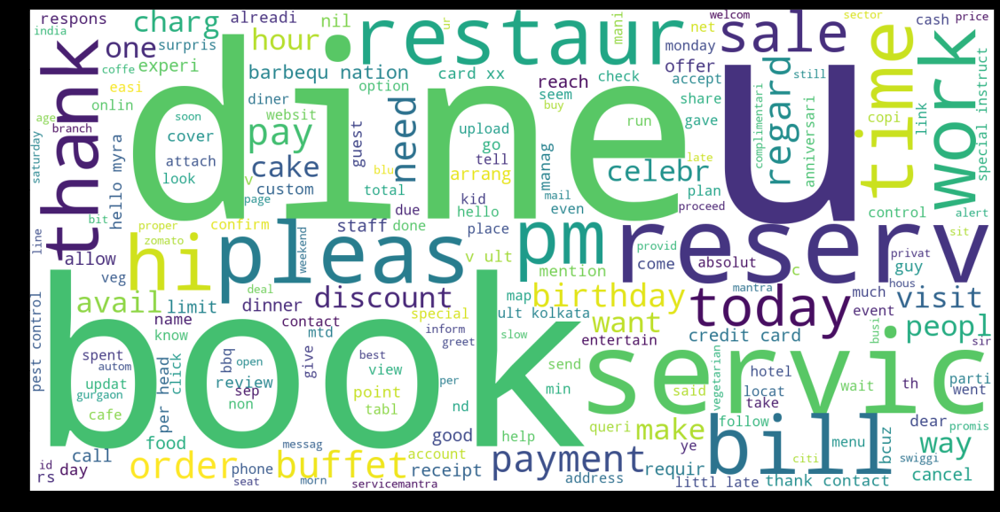

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==1]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df4[df4['cluster_W2V']==2]['text'])

14                  alreadi chat concern alreadi address
18                                         account block
21                               would wish cancel tiqri
30                             sorri plz cancel bymistak
34                                    alreadi msg cancel
                             ...                        
936               bbq nation model town curo high strret
969                                    cake cut ceremoni
970    green garlic kulcha deshi tako chettinad prawn...
986    sen mail adress agn leinen orang fr list resta...
992                              arrang surpris birthday
Name: text, Length: 96, dtype: object


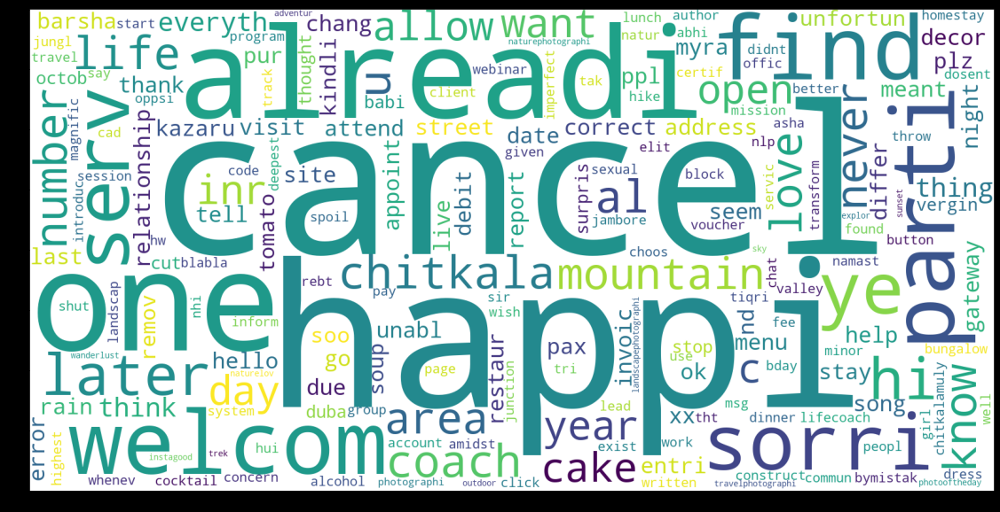

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==2]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df4[df4['cluster_W2V']==3]['text'])

3                               sorri book mistak
16                              charg advanc book
32                               hi plz make book
39                         hi want cancel book pl
43                                  cancel reserv
                          ...                    
971                                   know cancel
972      cancel book number barbequ nation oct pm
982                            mistak cancel book
985                     sorri pleas cancel reserv
990    barbecu nation would like book today guest
Name: text, Length: 121, dtype: object


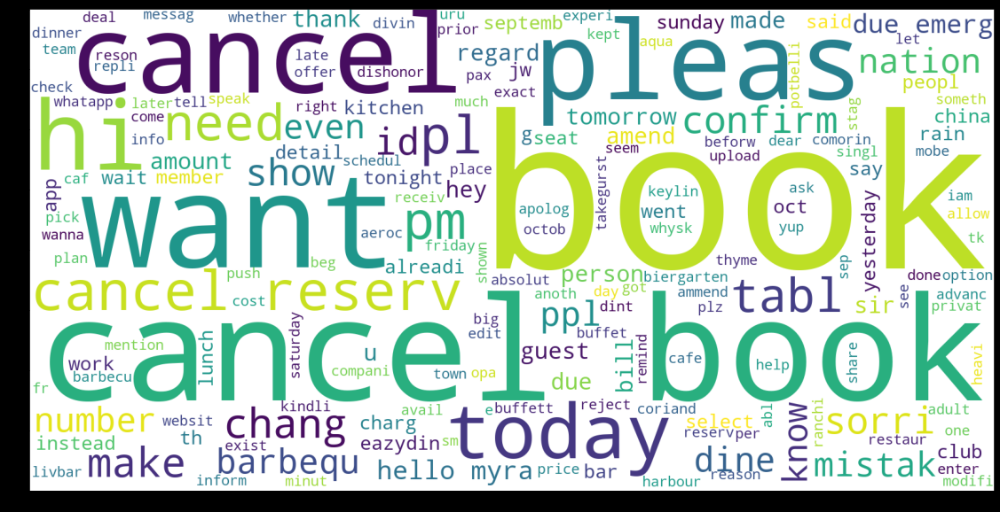

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==3]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df4[df4['cluster_W2V']==4]['text'])

1                            non veg buffet price member
8                                          said tie dine
9                                   exactli price person
12                                may know non veg price
13     hi eazydin prime member save everi time eat pl...
                             ...                        
968           rhink u read messag confirm declin restaur
979           hi trust dinner reserv confirm speak hotel
981           hello myra mayb one person abl accommod us
988    two coupl need call daiblo reserv entri done e...
995                   see time paid bill upload herewith
Name: text, Length: 242, dtype: object


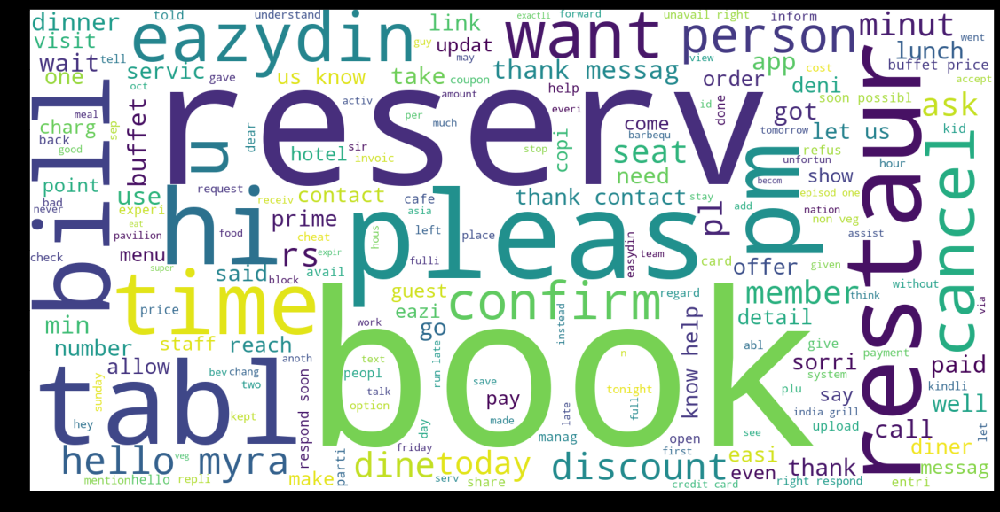

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==4]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df4[df4['cluster_W2V']==5]['text'])

2          make reserv bill bill present digit paid cash
4                                 much buffet per person
7                            bill current go reserv time
11     thank contact kanak interior pleas let us know...
17      thank contact benz packag pleas let us know help
                             ...                        
961                                 hi help chang reserv
966    hello myra select number guest soon confirm re...
975                            possibl chang reserv time
978                             make reserv misplac bill
984                    hello myra want know bill proceed
Name: text, Length: 204, dtype: object


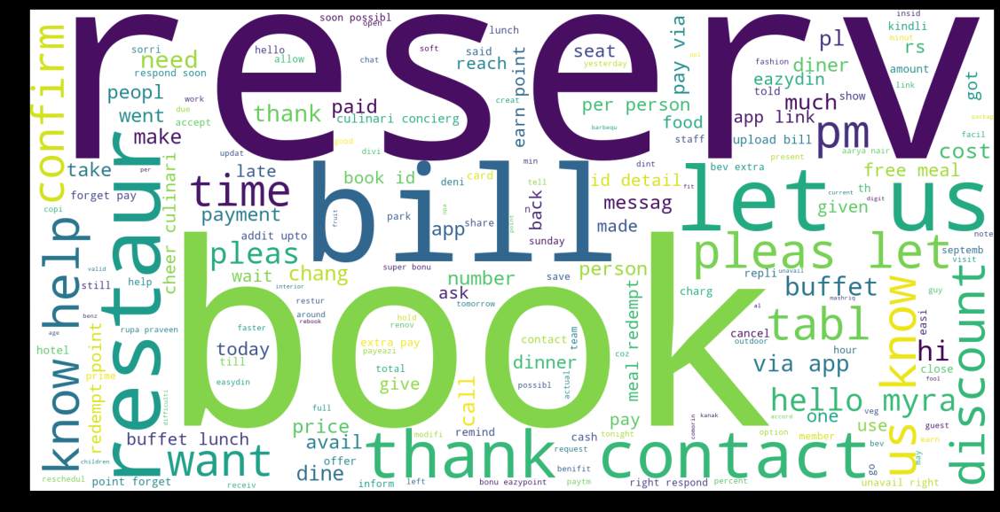

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==5]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 6

In [ ]:
print(df4[df4['cluster_W2V']==6]['text'])

10                              want cancel book
71                        hello want cancel book
78                           u pleas cancel book
91                            want chang book pm
102                                call say book
104                                       get pm
123                                          get
138                        pleas postpon book pm
139      one respond call want cancel book thank
166                barbequ nation sep pm book id
194                                 ju book tabl
199                          pl cancel tabl book
201                              want today book
202                              want book today
203                             want cancel book
207          pleas reschedul book peopl pm today
228                            pl extend book pm
258                    pleas cancl book id thank
260                               sep pm book id
262                               sep pm book id
273                 

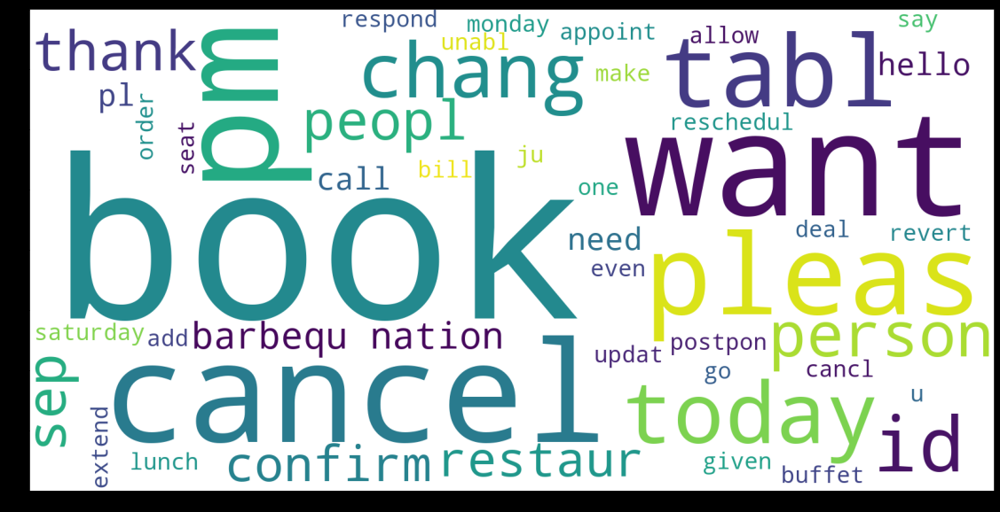

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df4[df4['cluster_W2V']==6]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# 3) Using Universal Sentence Encoder

In [ ]:
df5=df4
df5

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF,tokens_word,vectors_W2V,cluster_W2V
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[get, discount, food]","[[0.004462765, 0.00089486025, 0.001281267, 0.0...",0
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[non, veg, buffet, price, member]","[[0.005131776, -0.004905238, -0.0015936384, 0....",4
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[make, reserv, bill, bill, present, digit, pai...","[[-0.000308945, 0.0033469624, -0.0046594264, -...",5
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0,"[sorri, book, mistak]","[[0.0019674986, 0.0011526848, -0.0016646305, 0...",3
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[much, buffet, per, person]","[[0.00031941914, -0.00030237, 0.0012645756, 0....",5
...,...,...,...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[arrang, surpris, birthday]","[[0.0021385285, 0.0024560557, -0.001455537, 0....",2
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[u, arrang, surpris, birthday]","[[-0.0013370005, 0.0015429106, 0.00010546608, ...",1
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4,"[hello, dress, code, punjab, grill, pleas, men...","[[0.00028019585, -0.00057927635, -0.0034817406...",1
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[see, time, paid, bill, upload, herewith]","[[-0.0018154272, -0.0022914498, 0.0012173563, ...",4


In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# load the Universal Sentence Encoder
embed = hub.KerasLayer("https://tfhub.dev/google/universal-sentence-encoder/4")

### Cosine Similarity

In [ ]:
# create embeddings for each sentence
sentence_embeddings_USE = embed(df5['text'])


# calculate cosine similarity between all sentence pairs
similarity = cosine_similarity(sentence_embeddings_USE)
similarity

array([[ 1.0000001 ,  0.37647796,  0.13839422, ...,  0.08087757,
         0.1560639 ,  0.15297756],
       [ 0.37647796,  1.        ,  0.04888894, ...,  0.15595813,
         0.02657519,  0.08296604],
       [ 0.13839422,  0.04888894,  0.9999997 , ...,  0.04781007,
         0.55951023, -0.01232195],
       ...,
       [ 0.08087757,  0.15595813,  0.04781007, ...,  1.0000001 ,
         0.00797962, -0.03299251],
       [ 0.1560639 ,  0.02657519,  0.55951023, ...,  0.00797962,
         1.        , -0.0372434 ],
       [ 0.15297756,  0.08296604, -0.01232195, ..., -0.03299251,
        -0.0372434 ,  1.        ]], dtype=float32)

In [ ]:
df5['vectors_USE'] = 0
df5['vectors_USE'] = sentence_embeddings_USE

### Clustering

In [ ]:
sentence_embeddings_USE = np.array(sentence_embeddings_USE)

In [ ]:
from sklearn.decomposition import PCA
reduced_sentence_embeddings_USE = PCA(n_components=2).fit_transform(sentence_embeddings_USE)

In [ ]:
from sklearn.cluster import KMeans
k_rng=range(1,10)
sse=[]
for k in k_rng:
  km = KMeans(n_clusters=k)
  km.fit(reduced_sentence_embeddings_USE)
  sse.append(km.inertia_)

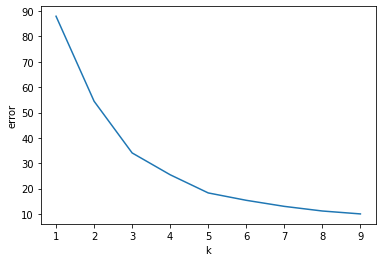

In [ ]:
from matplotlib import pyplot as plt
plt.xlabel('k')
plt.ylabel("error")
plt.plot(k_rng,sse)

In [ ]:
#similarity1 = cosine_similarity(feature_vectors1)
kmeans = KMeans(n_clusters=9)
kmeans.fit(reduced_sentence_embeddings_USE)

KMeans(n_clusters=9)

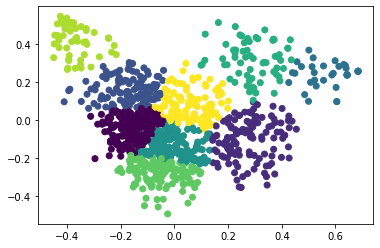

In [ ]:
# Plot the reduced vectors with different colors for each cluster
plt.scatter(reduced_sentence_embeddings_USE[:, 0], reduced_sentence_embeddings_USE[:, 1], c=kmeans.labels_)
plt.show()

In [ ]:
# reduced_sentence_embeddings_USE = reduced_sentence_embeddings_USE.astype(np.float)
df5['cluster_USE'] = kmeans.predict(reduced_sentence_embeddings_USE)
clear_output()

### Sentence which are similar to first sentence

In [ ]:
def cosine_similarity(vec1, vec2):
    dot_product = np.dot(vec1, vec2)
    norm_vec1 = np.linalg.norm(vec1)
    norm_vec2 = np.linalg.norm(vec2)
    return dot_product / (norm_vec1 * norm_vec2)


In [ ]:
x=0
print(df5['text'][0])
print(0)

for i in range(len(df5)):
  similarity = cosine_similarity(sentence_embeddings_USE[x],sentence_embeddings_USE[i])
  if similarity>=0.7:
    print(df5['text'][i])
    print(similarity)
    print(i)

get discount food
0
get discount food
1.0
0


## Clusters

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df5.groupby('cluster_USE').size()
print(result)

cluster_USE
0    204
1    128
2    117
3     35
4    159
5     64
6    129
7     52
8    109
dtype: int64


### Cluster : 0

In [ ]:
print(df5[df5['cluster_USE']==0]['text'])

5      payment alert spent rs credit card xx radisson...
6                                          complain help
12                                may know non veg price
13     hi eazydin prime member save everi time eat pl...
14                  alreadi chat concern alreadi address
                             ...                        
991    increas instagram follow peopl requir requir t...
992                              arrang surpris birthday
993                            u arrang surpris birthday
994    hello dress code punjab grill pleas men wear s...
995                   see time paid bill upload herewith
Name: text, Length: 204, dtype: object


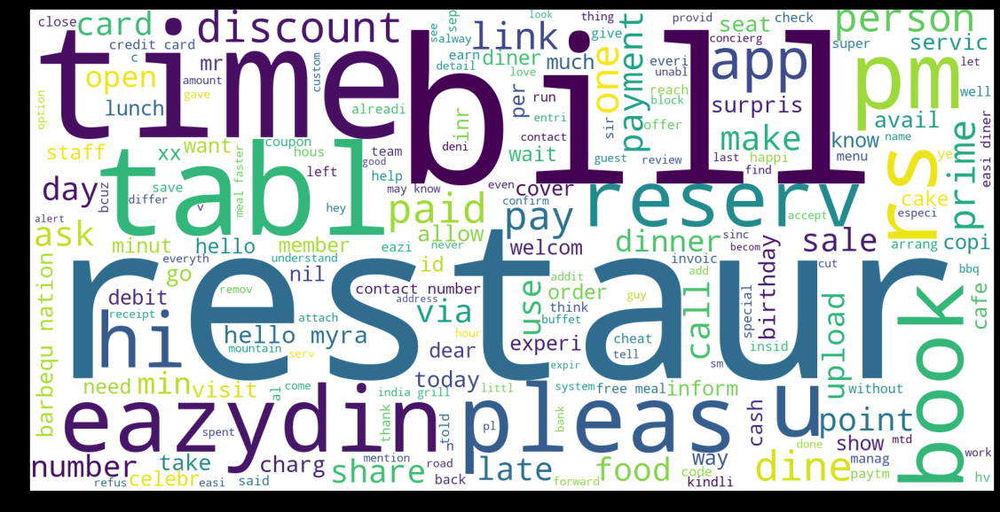

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==0]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df5[df5['cluster_USE']==1]['text'])

3                               sorri book mistak
16                              charg advanc book
32                               hi plz make book
49                                 much book cost
54                     hello need modifi book ppl
                          ...                    
964                            want pm unabl book
974                                book deal bill
976                                 book saturday
989                    get book person today even
990    barbecu nation would like book today guest
Name: text, Length: 128, dtype: object


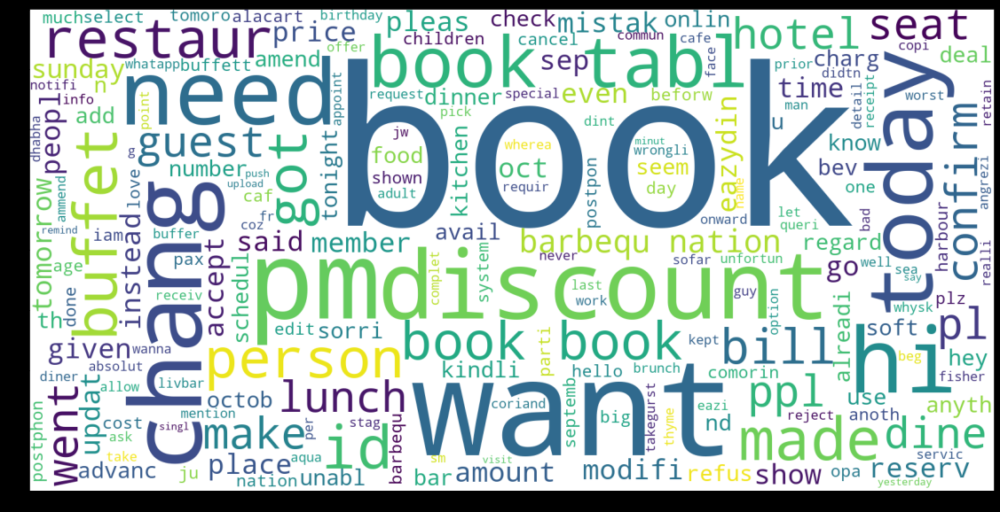

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==1]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df5[df5['cluster_USE']==2]['text'])

37                            thank choos elit construct
38                                  hi call reschedul pm
40                   whenev click pay button throw error
55     dear guest finest greet thank messag unavail r...
57     welcom verandah moonshin thank contact set vac...
                             ...                        
960                                    pl give call back
962                           hello myra regard k option
981           hello myra mayb one person abl accommod us
984                    hello myra want know bill proceed
986    sen mail adress agn leinen orang fr list resta...
Name: text, Length: 117, dtype: object


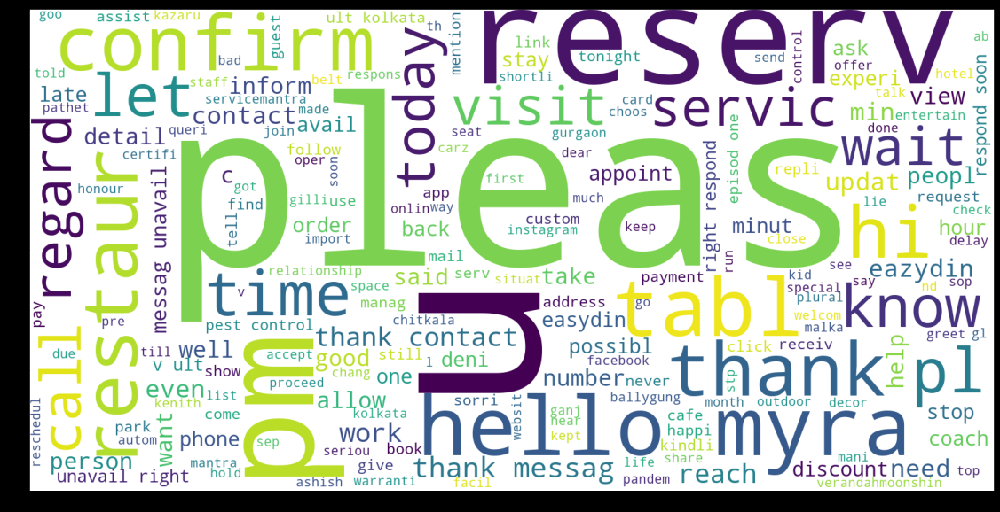

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==2]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df5[df5['cluster_USE']==3]['text'])

10                          want cancel book
39                    hi want cancel book pl
50               would like cancel book tabl
71                    hello want cancel book
78                       u pleas cancel book
81                    would like cancel book
89         due person reson want cancel book
199                      pl cancel tabl book
203                         want cancel book
245                   would like cancel book
286                   would like cancel book
314                         want cancel seat
315                         u pl cancel book
332                   sorri want cancel book
346                    sorri say book cancel
386                   would like cancel book
396          plan cancel pl cancel tabl book
419                         need cancel book
456                         cancel book town
457                        u ppl cancel book
465        cancel book reserv privat compani
485                   would like cancel book
516       

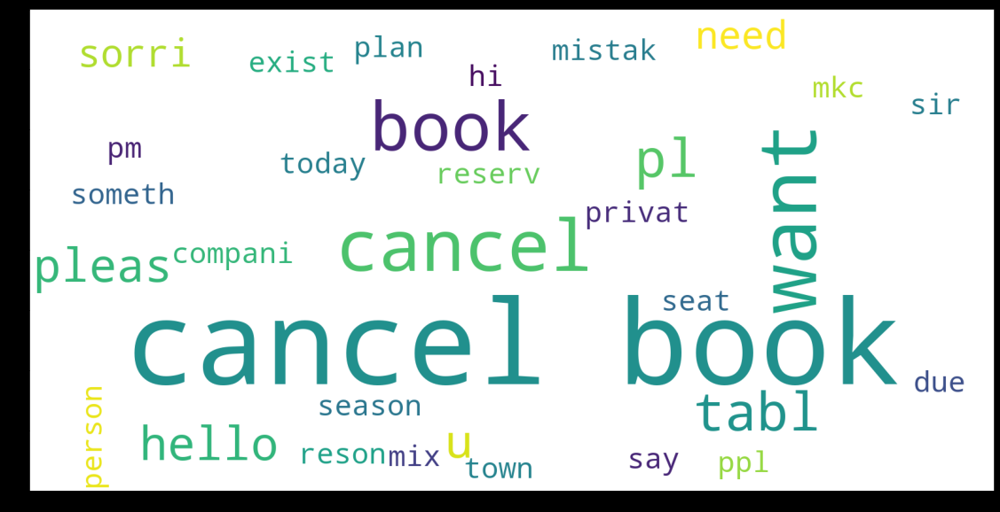

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==3]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df5[df5['cluster_USE']==4]['text'])

9                              exactli price person
18                                    account block
25     tell exactli much bill expect book today nyc
26                          tell bill amount advanc
33                              mistak select guest
                           ...                     
955             went late dinner book still benefit
967                                littl late reach
975                       possibl chang reserv time
978                        make reserv misplac bill
980                     show pm reserv time account
Name: text, Length: 159, dtype: object


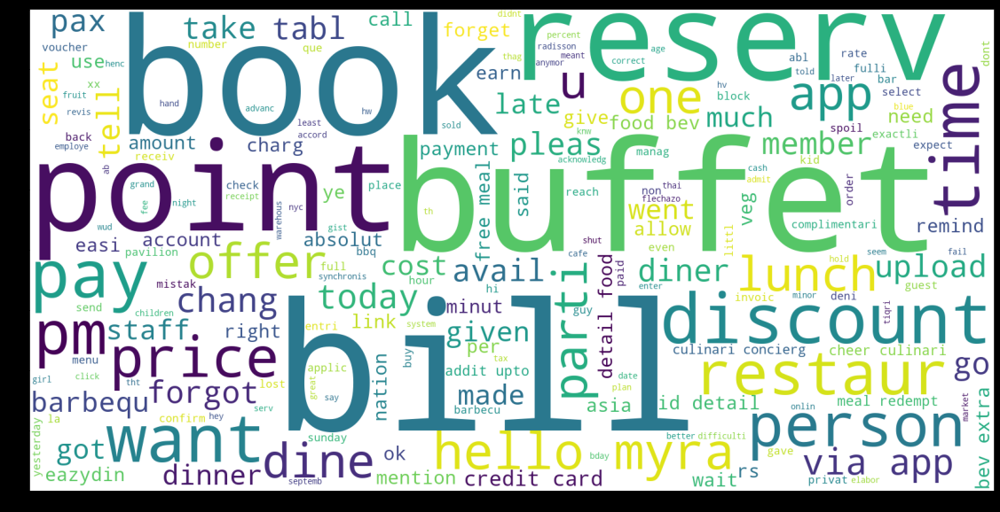

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==4]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df5[df5['cluster_USE']==5]['text'])

21                      would wish cancel tiqri
30                    sorri plz cancel bymistak
43                                cancel reserv
44                            cancel websit app
52                  hi someth came cancel pleas
                         ...                   
948            know cancel help tell come today
971                                 know cancel
972    cancel book number barbequ nation oct pm
983                 pleas confirm book th octob
985                   sorri pleas cancel reserv
Name: text, Length: 64, dtype: object


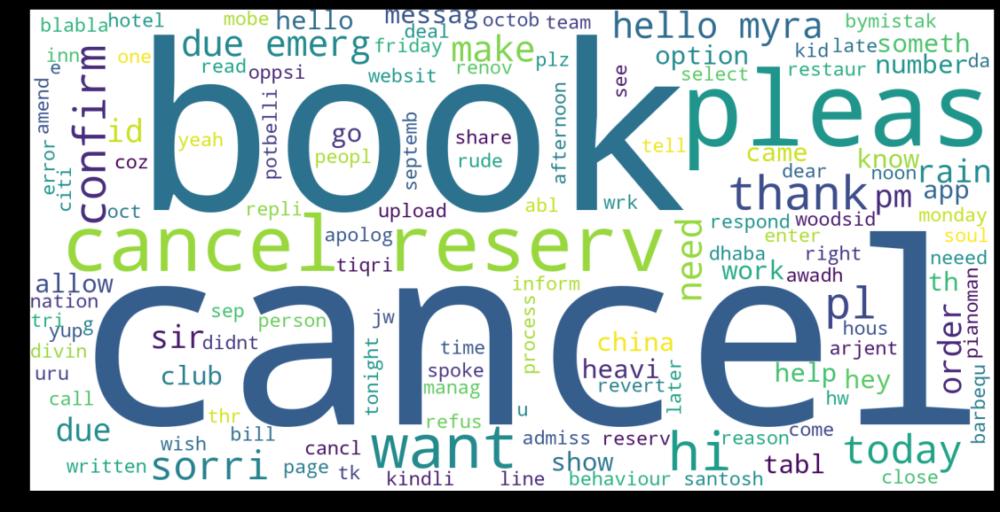

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==5]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 6

In [ ]:
print(df5[df5['cluster_USE']==6]['text'])

0                                  get discount food
1                        non veg buffet price member
2      make reserv bill bill present digit paid cash
4                             much buffet per person
7                        bill current go reserv time
                           ...                      
933                                  cut cake jetlag
935                       u organ candl night dinner
969                                cake cut ceremoni
977                                        bill dine
996                                 restaur page app
Name: text, Length: 129, dtype: object


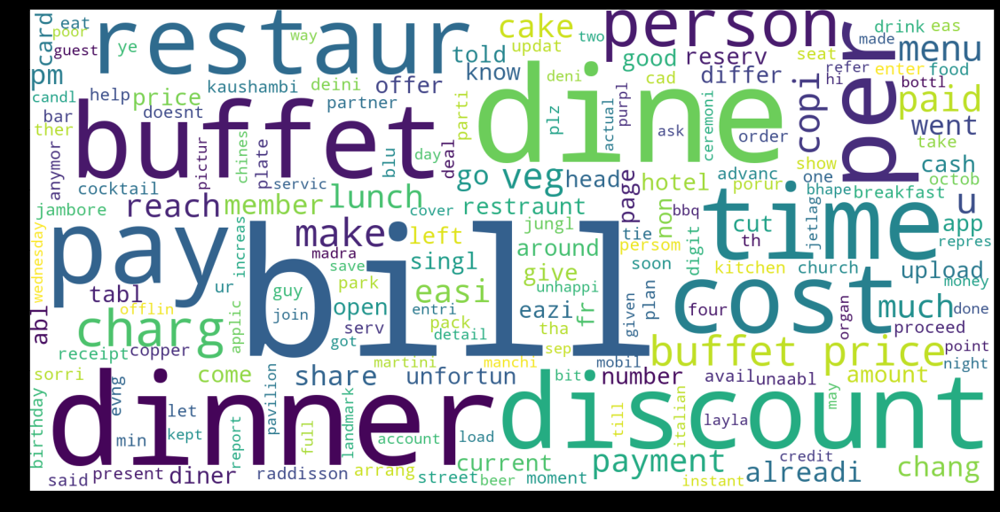

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df5[df5['cluster_USE']==6]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# 4) Using BERT embeddings

In [ ]:
df6=df5
df6

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF,tokens_word,vectors_W2V,cluster_W2V,vectors_USE,cluster_USE
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[get, discount, food]","[[0.004462765, 0.00089486025, 0.001281267, 0.0...",0,-0.019439,6
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[non, veg, buffet, price, member]","[[0.005131776, -0.004905238, -0.0015936384, 0....",4,0.034923,6
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[make, reserv, bill, bill, present, digit, pai...","[[-0.000308945, 0.0033469624, -0.0046594264, -...",5,-0.066831,6
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0,"[sorri, book, mistak]","[[0.0019674986, 0.0011526848, -0.0016646305, 0...",3,0.005782,1
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[much, buffet, per, person]","[[0.00031941914, -0.00030237, 0.0012645756, 0....",5,-0.064287,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[arrang, surpris, birthday]","[[0.0021385285, 0.0024560557, -0.001455537, 0....",2,-0.087437,0
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[u, arrang, surpris, birthday]","[[-0.0013370005, 0.0015429106, 0.00010546608, ...",1,-0.080673,0
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4,"[hello, dress, code, punjab, grill, pleas, men...","[[0.00028019585, -0.00057927635, -0.0034817406...",1,0.031258,0
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[see, time, paid, bill, upload, herewith]","[[-0.0018154272, -0.0022914498, 0.0012173563, ...",4,0.001567,0


In [ ]:
# !pip install tensorflow-text
# !pip install -U tensorflow-text==2.9.0

In [ ]:
# import tensorflow as tf
# import tensorflow_hub as hub
# import tensorflow_text as text
# # Load pre-trained BERT model and tokenizer
# bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
# bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
!pip install sentence-transformers
from sentence_transformers import SentenceTransformer
model= SentenceTransformer('bert-base-nli-mean-tokens')
clear_output()

### vectors

In [ ]:
sentence_embeddings_BERT = model.encode(df6['text'])

print('Sample BERT embedding vector - length', len(sentence_embeddings_BERT[0]))
print('Sample BERT embedding vector - note includes negative values', sentence_embeddings_BERT[0])

Sample BERT embedding vector - length 768
Sample BERT embedding vector - note includes negative values [-0.52200043 -0.33035466  1.0841568   0.08025678  0.36498788  0.5050198
 -0.6964115   0.8548442   0.55338573 -0.48698488 -0.22011328  0.88524735
  0.49050325  0.0178641  -0.08878993 -0.3216408  -0.5024778  -0.28431797
  0.2091341  -0.5132277  -0.18981649  0.04564043 -0.6479241  -0.16639832
 -0.20264152  0.5953869  -0.18808511 -0.62989604 -0.01467676  0.10662393
 -0.07452415  0.9308788   0.70840144 -0.26937127 -0.49034652 -0.09212136
  0.46769077  0.2200263   0.07350123  1.274368    0.44962367  0.3669937
  0.7069903   1.2577581  -0.14192536 -0.4061606   0.15404537  0.2854047
 -0.76133585 -1.1550736   0.857586   -1.4797366   0.49167857  0.7201675
 -0.77059585  1.3774726  -0.34198713 -0.5455728   0.27913833  0.31227243
 -1.0190914   0.37242308  0.7272472   0.18960258 -1.1153389  -0.21851225
 -0.65916497  0.22635388  0.1846028  -0.6023792   0.5084466  -1.1534048
 -0.62787867  0.51535195 -

In [ ]:
df6['vectors_BERT']=0
df6['vectors_BERT']=sentence_embeddings_BERT


### similarity

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
similarity_BERT = cosine_similarity(sentence_embeddings_BERT)
similarity_BERT

array([[1.        , 0.55160356, 0.5500473 , ..., 0.4693656 , 0.5298735 ,
        0.6012438 ],
       [0.55160356, 0.9999998 , 0.47689727, ..., 0.3761615 , 0.39153555,
        0.4355826 ],
       [0.5500473 , 0.47689727, 1.        , ..., 0.24035065, 0.75939214,
        0.42435876],
       ...,
       [0.4693656 , 0.3761615 , 0.24035065, ..., 0.9999999 , 0.25880572,
        0.3645823 ],
       [0.5298735 , 0.39153555, 0.75939214, ..., 0.25880572, 0.9999994 ,
        0.51434374],
       [0.6012438 , 0.4355826 , 0.42435876, ..., 0.3645823 , 0.51434374,
        0.9999998 ]], dtype=float32)

In [ ]:
query = "I want to cancel reservation"
query_vec = model.encode([query])[0]

### Sentence which are similar to first sentence

In [ ]:
print(df6['text'][0])
print(0)
vec1 = sentence_embeddings_BERT[x].reshape(1,-1)
for i in range(len(df6)):
  vec2 = sentence_embeddings_BERT[i].reshape(1, -1)
  similarity=cosine_similarity(vec1,vec2)
  if similarity>=0.7:
    print(df6['text'][i])
    print(similarity)
    print(i)

get discount food
0
get discount food
[[1.0000002]]
0
get drink menu
[[0.7205125]]
27
ur lunch buffet price
[[0.79736435]]
114
pay bill discount
[[0.8039557]]
143
avail discount order use restaur websit contact
[[0.75879353]]
159
cost buffet
[[0.7300366]]
167
buffet price come persom
[[0.7038449]]
172
discount restaur
[[0.8241506]]
197
go get discount
[[0.79943585]]
318
want buffet lunch person th septemb
[[0.73765767]]
328
get discount
[[0.78265476]]
365
get discount brunch buffer
[[0.8246435]]
393
went got discount retain bill
[[0.7836338]]
481
today discount bar que buy voucher
[[0.7871464]]
503
restaur deni discount
[[0.72955954]]
554
got discount
[[0.74412787]]
581
may know buffet price
[[0.71520245]]
593
want take buffet lunch
[[0.76727706]]
622
made book nd oct want know price buffet lunch
[[0.7120115]]
636
lunch paid around easi diner discount
[[0.751027]]
672
want know price price buffet dinner
[[0.7009303]]
684
offer buffet
[[0.77525973]]
713
dine yazu give us discount
[[0.78

In [ ]:
# def cosine(u, v):
#   return np.dot(u, v) / (np.linalg.norm(u) * np.linalg.norm(v))
# for sent in df6['text']:
#   sim = cosine(query_vec, model.encode([sent])[0])
#   print("Sentence = ", sent, "; similarity = ", sim)

### Clustering

In [ ]:
from sklearn.decomposition import PCA
reduced_sentence_embeddings_BERT = PCA(n_components=2).fit_transform(sentence_embeddings_BERT)

In [ ]:
k_rng=range(1,10)
sse=[]
for k in k_rng:
  km = KMeans(n_clusters=k)
  km.fit(reduced_sentence_embeddings_BERT)
  sse.append(km.inertia_)


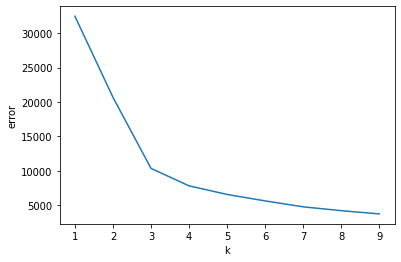

In [ ]:
from matplotlib import pyplot as plt
plt.xlabel('k')
plt.ylabel("error")
plt.plot(k_rng,sse)

In [ ]:
#similarity1 = cosine_similarity(feature_vectors1)
kmeans = KMeans(n_clusters=9)
kmeans.fit(reduced_sentence_embeddings_BERT)

KMeans(n_clusters=9)

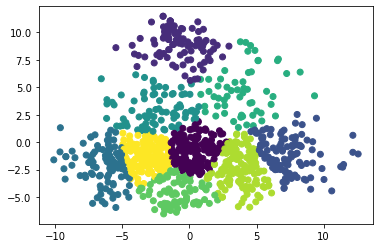

In [ ]:
# Plot the reduced vectors with different colors for each cluster
plt.scatter(reduced_sentence_embeddings_BERT[:, 0], reduced_sentence_embeddings_BERT[:, 1], c=kmeans.labels_)
plt.show()

In [ ]:
df6['cluster_BERT'] = kmeans.predict(reduced_sentence_embeddings_BERT)

In [ ]:
df6

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF,tokens_word,vectors_W2V,cluster_W2V,vectors_USE,cluster_USE,vectors_BERT,cluster_BERT
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[get, discount, food]","[[0.004462765, 0.00089486025, 0.001281267, 0.0...",0,-0.019439,6,-0.522000,7
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[non, veg, buffet, price, member]","[[0.005131776, -0.004905238, -0.0015936384, 0....",4,0.034923,6,-0.155360,5
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[make, reserv, bill, bill, present, digit, pai...","[[-0.000308945, 0.0033469624, -0.0046594264, -...",5,-0.066831,6,-0.761719,7
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0,"[sorri, book, mistak]","[[0.0019674986, 0.0011526848, -0.0016646305, 0...",3,0.005782,1,-0.527465,4
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[much, buffet, per, person]","[[0.00031941914, -0.00030237, 0.0012645756, 0....",5,-0.064287,6,-0.297931,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[arrang, surpris, birthday]","[[0.0021385285, 0.0024560557, -0.001455537, 0....",2,-0.087437,0,-0.481709,0
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[u, arrang, surpris, birthday]","[[-0.0013370005, 0.0015429106, 0.00010546608, ...",1,-0.080673,0,-0.360373,0
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4,"[hello, dress, code, punjab, grill, pleas, men...","[[0.00028019585, -0.00057927635, -0.0034817406...",1,0.031258,0,1.011950,7
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[see, time, paid, bill, upload, herewith]","[[-0.0018154272, -0.0022914498, 0.0012173563, ...",4,0.001567,0,-0.096249,0


## Clusters

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df6.groupby('cluster_BERT').size()
print(result)

cluster_BERT
0    161
1    100
2    113
3    108
4     85
5     57
6     82
7    128
8    163
dtype: int64


### Cluster : 0

In [ ]:
print(df6[df6['cluster_BERT']==0]['text'])

4                  much buffet per person
7             bill current go reserv time
8                           said tie dine
12                 may know non veg price
35                 serv alcohol also asha
                      ...                
989            get book person today even
992               arrang surpris birthday
993             u arrang surpris birthday
995    see time paid bill upload herewith
996                      restaur page app
Name: text, Length: 161, dtype: object


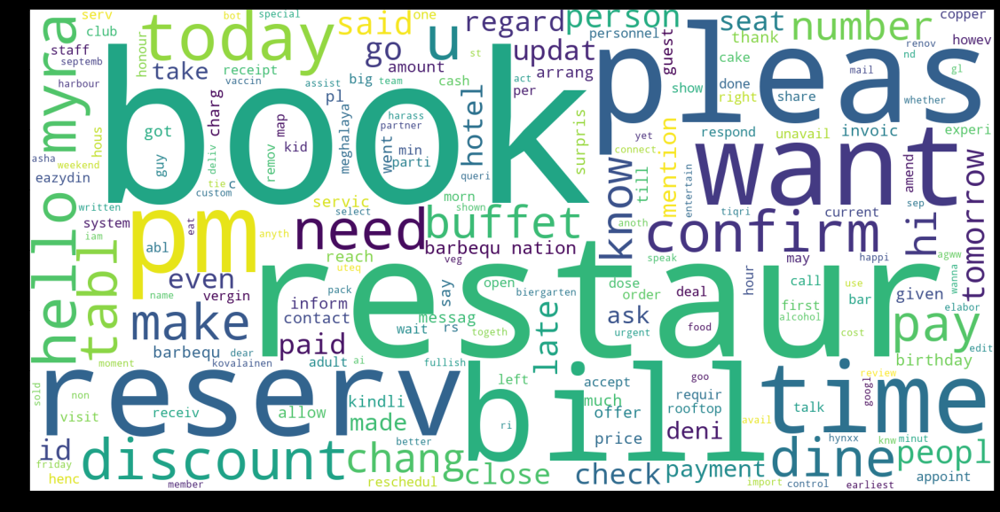

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==0]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df6[df6['cluster_BERT']==1]['text'])

10                             want cancel book
21                      would wish cancel tiqri
24          visit cancel plan proper sit arrang
30                    sorri plz cancel bymistak
34                           alreadi msg cancel
                         ...                   
963                            want cancel book
971                                 know cancel
972    cancel book number barbequ nation oct pm
982                          mistak cancel book
985                   sorri pleas cancel reserv
Name: text, Length: 100, dtype: object


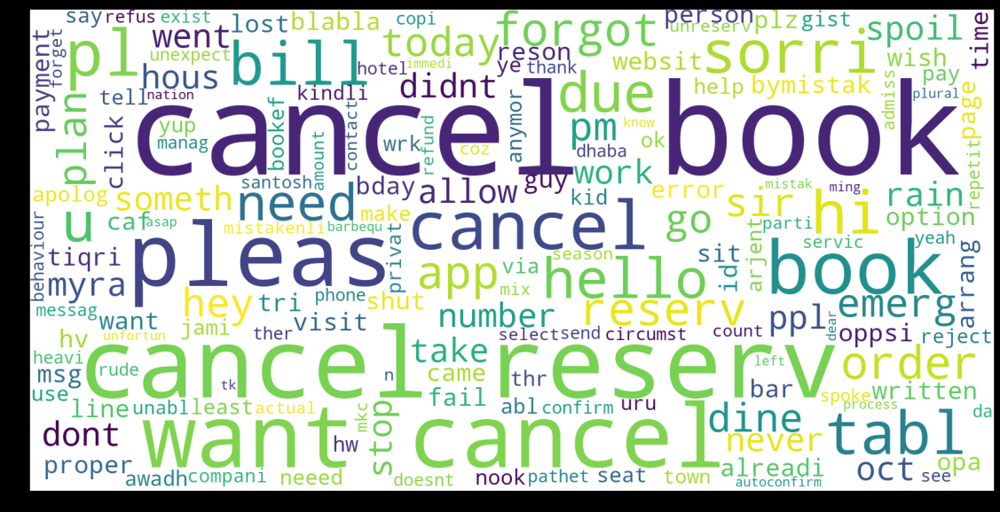

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==1]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df6[df6['cluster_BERT']==2]['text'])

13     hi eazydin prime member save everi time eat pl...
31     food good look resist head art dum rang indulg...
51                               ye dinner jungl jambore
55     dear guest finest greet thank messag unavail r...
57     welcom verandah moonshin thank contact set vac...
                             ...                        
957    usual book tabl ill ask select menu like veg n...
966    hello myra select number guest soon confirm re...
970    green garlic kulcha deshi tako chettinad prawn...
986    sen mail adress agn leinen orang fr list resta...
988    two coupl need call daiblo reserv entri done e...
Name: text, Length: 113, dtype: object


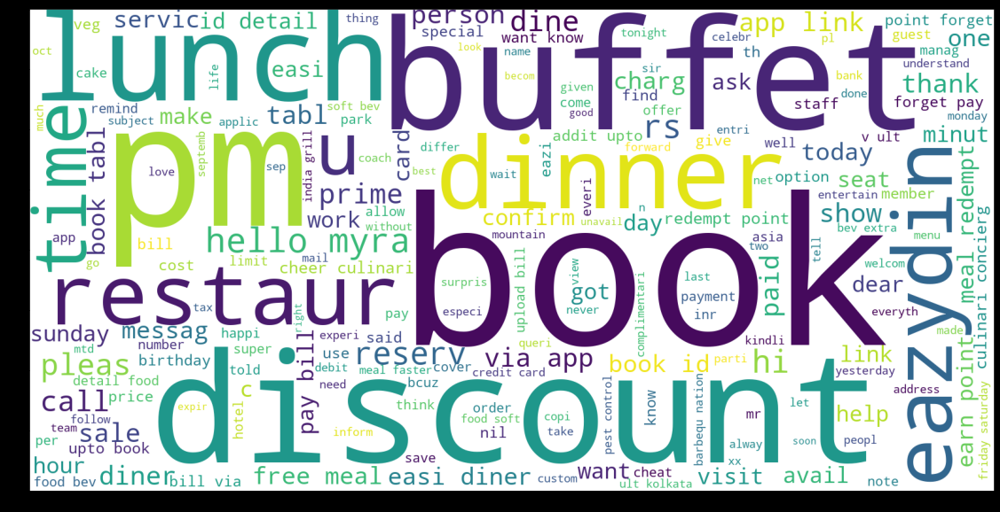

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==2]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df6[df6['cluster_BERT']==3]['text'])

9              exactli price person
15                              min
20                         abl make
36                block reach minut
42                         get back
                   ...             
900                  would like opt
914         al wakha al barsha open
927                   get touch one
952    want provid special instruct
960               pl give call back
Name: text, Length: 108, dtype: object


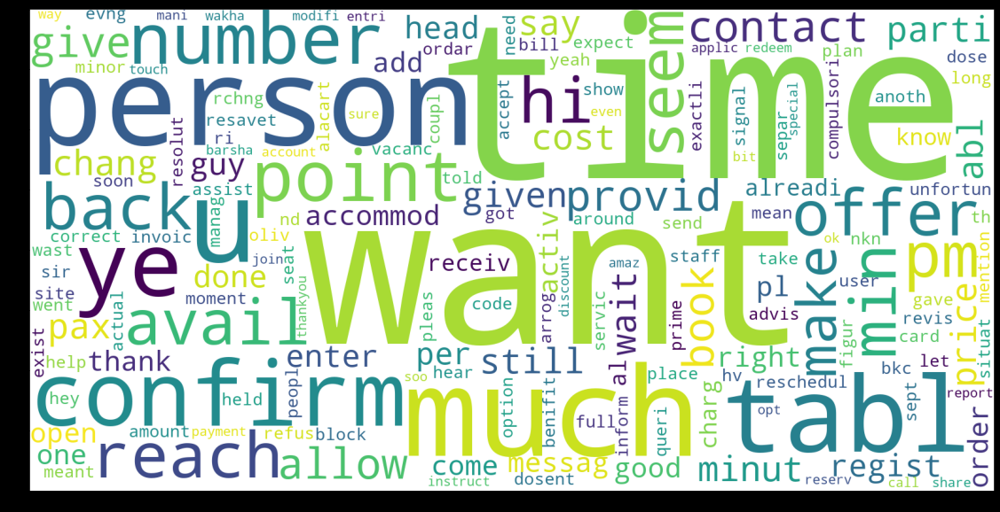

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==3]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df6[df6['cluster_BERT']==4]['text'])

3                                      sorri book mistak
18                                         account block
19                             dine unfortun bill anymor
29                              way might get littl late
49                                        much book cost
                             ...                        
932                         buffet price fr singl person
958    pl book keylin experi aeroc pm today instead book
964                                   want pm unabl book
967                                     littl late reach
978                             make reserv misplac bill
Name: text, Length: 85, dtype: object


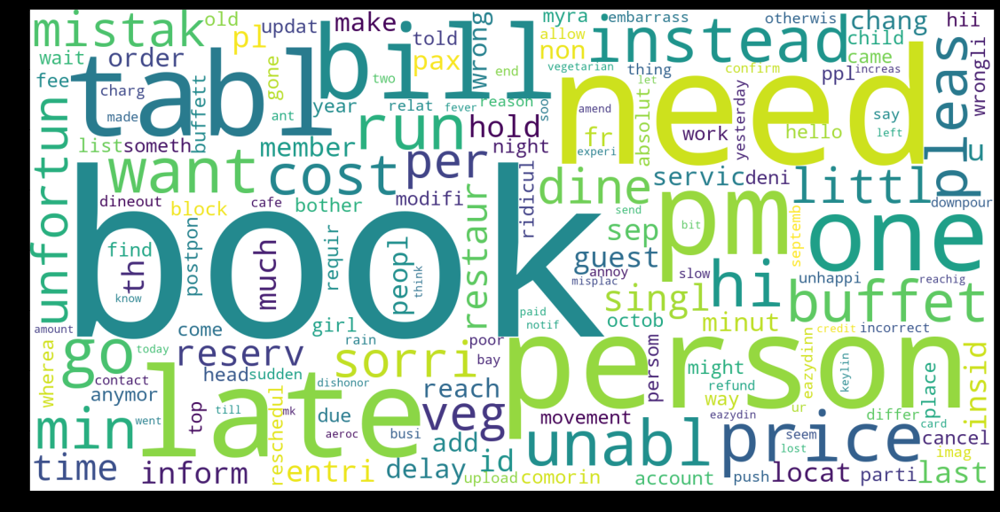

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==4]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df6[df6['cluster_BERT']==5]['text'])

1                            non veg buffet price member
28                  pleas block ping reserv tonight full
40                   whenev click pay button throw error
76               buffet book children age discount price
101    hotel staff call told book app valid fool cust...
120                   hello team pleas cancel deal thank
139              one respond call want cancel book thank
178    hi team make time bill system wait min without...
219         hello myra need cancel book today china club
240                  sorri could make guest cancel visit
261    sir sorri inform book jw due reason make pl ca...
285    left restaur one miner water due mild rain out...
303                             dint dine takegurst book
307                              hello myra run late min
326    hello book talli turmer worli pm run late pl i...
333                   pl cancel book late due emerg work
336                     never ever book anyth eazi diner
368    sorri let us drove way f

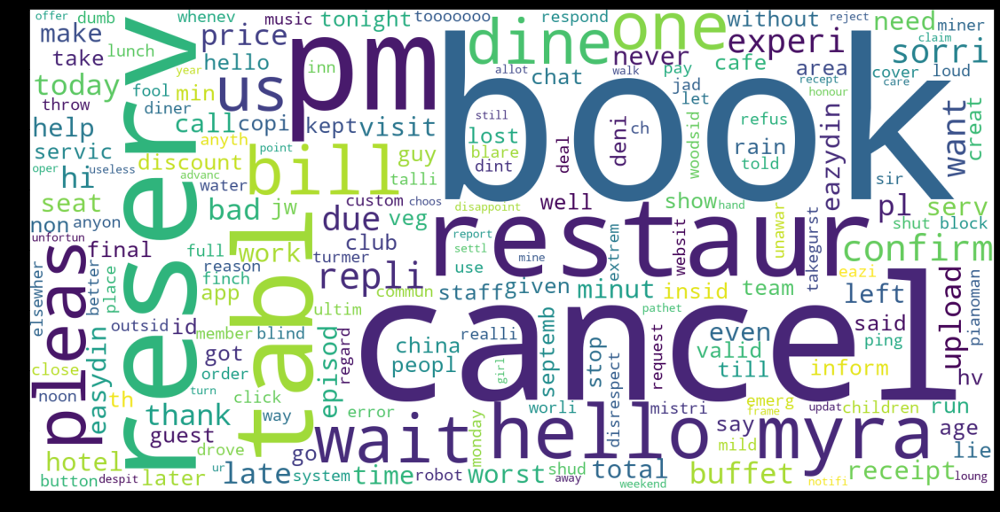

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==5]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 6

In [ ]:
print(df6[df6['cluster_BERT']==6]['text'])

11     thank contact kanak interior pleas let us know...
17      thank contact benz packag pleas let us know help
22                  thank contact pleas let us know help
37                            thank choos elit construct
72     thank contact al mashriq fit pleas let us know...
                             ...                        
949                    pleas share number contact person
953    thank contact rupam kumari pleas let us know help
954    thank messag fit studio unavail right respond ...
961                                 hi help chang reserv
965                           put paytm code avail offer
Name: text, Length: 82, dtype: object


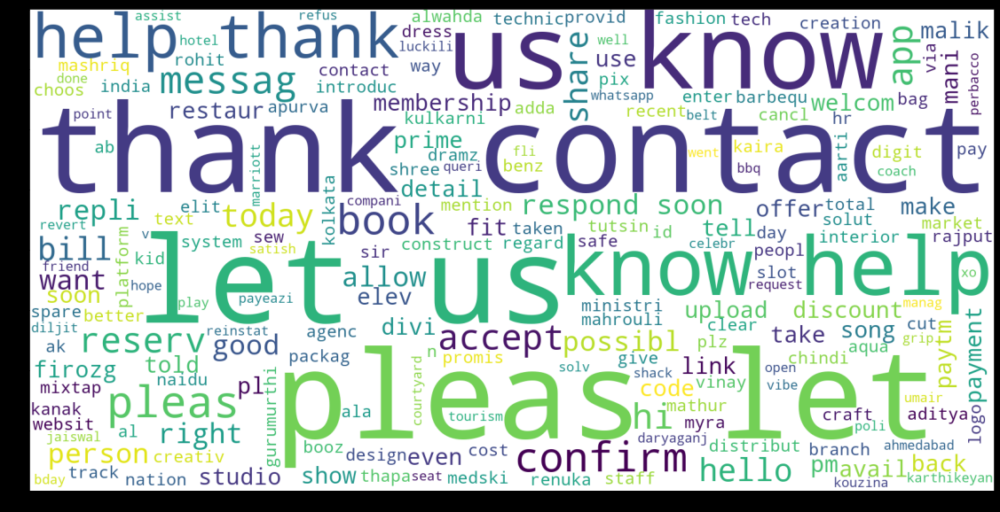

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df6[df6['cluster_BERT']==6]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# 5) Doc2Vec

In [ ]:
df7=df6

### Tokens

In [ ]:
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize

#lambda 1 liner fn
df7["tokens_sent"] = df7["text"].apply(lambda x: sent_tokenize(x))
clear_output()
df7

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF,tokens_word,vectors_W2V,cluster_W2V,vectors_USE,cluster_USE,vectors_BERT,cluster_BERT,tokens_sent
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[get, discount, food]","[[0.004462765, 0.00089486025, 0.001281267, 0.0...",0,-0.019439,6,-0.522000,7,[get discount food]
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[non, veg, buffet, price, member]","[[0.005131776, -0.004905238, -0.0015936384, 0....",4,0.034923,6,-0.155360,5,[non veg buffet price member]
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[make, reserv, bill, bill, present, digit, pai...","[[-0.000308945, 0.0033469624, -0.0046594264, -...",5,-0.066831,6,-0.761719,7,[make reserv bill bill present digit paid cash]
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0,"[sorri, book, mistak]","[[0.0019674986, 0.0011526848, -0.0016646305, 0...",3,0.005782,1,-0.527465,4,[sorri book mistak]
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[much, buffet, per, person]","[[0.00031941914, -0.00030237, 0.0012645756, 0....",5,-0.064287,6,-0.297931,0,[much buffet per person]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[arrang, surpris, birthday]","[[0.0021385285, 0.0024560557, -0.001455537, 0....",2,-0.087437,0,-0.481709,0,[arrang surpris birthday]
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[u, arrang, surpris, birthday]","[[-0.0013370005, 0.0015429106, 0.00010546608, ...",1,-0.080673,0,-0.360373,0,[u arrang surpris birthday]
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4,"[hello, dress, code, punjab, grill, pleas, men...","[[0.00028019585, -0.00057927635, -0.0034817406...",1,0.031258,0,1.011950,7,[hello dress code punjab grill pleas men wear ...
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[see, time, paid, bill, upload, herewith]","[[-0.0018154272, -0.0022914498, 0.0012173563, ...",4,0.001567,0,-0.096249,0,[see time paid bill upload herewith]


### Similarity

In [ ]:
from gensim.models import Doc2Vec
from sklearn.metrics.pairwise import cosine_similarity
from gensim.models.doc2vec import TaggedDocument
#tokens=
tagged_sentences = [TaggedDocument(words=sentence, tags=[str(i)]) for i, sentence in enumerate(df7['tokens_sent'])]


# Train a doc2vec model on your dataset
doc2vec_model = Doc2Vec(tagged_sentences, vector_size=100, window=5, min_count=2, workers=4)


# Get vector representations of sentences
sentence_vectors_D2V = [doc2vec_model.infer_vector(sentence) for sentence in df7['tokens_sent']]

# Calculate cosine similarity between all pairs of vectors
similarities = cosine_similarity(sentence_vectors_D2V)
clear_output()

In [ ]:
similarities

array([[ 1.        ,  0.06068265, -0.09397898, ...,  0.03579592,
        -0.04217908,  0.05330225],
       [ 0.06068265,  0.9999999 ,  0.04440987, ...,  0.10775112,
         0.04494664, -0.1282704 ],
       [-0.09397898,  0.04440987,  1.0000002 , ..., -0.00273939,
         0.06901564, -0.10410264],
       ...,
       [ 0.03579592,  0.10775112, -0.00273939, ...,  1.0000004 ,
        -0.0329136 , -0.07187311],
       [-0.04217908,  0.04494664,  0.06901564, ..., -0.0329136 ,
         1.        , -0.11225171],
       [ 0.05330225, -0.1282704 , -0.10410264, ..., -0.07187311,
        -0.11225171,  0.99999976]], dtype=float32)

In [ ]:
df7['vectors_D2V']=0
df7['vectors_D2V']=sentence_vectors_D2V

### Clustering

In [ ]:
from sklearn.decomposition import PCA
reduced_sentence_embeddings_D2V = PCA(n_components=2).fit_transform(sentence_vectors_D2V)

In [ ]:
from sklearn.cluster import KMeans
k_rng=range(1,10)
sse=[]
for k in k_rng:
  km = KMeans(n_clusters=k)
  km.fit(reduced_sentence_embeddings_D2V)
  sse.append(km.inertia_)


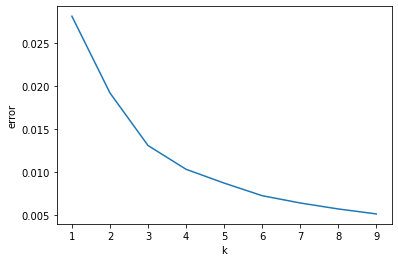

In [ ]:
from matplotlib import pyplot as plt
plt.xlabel('k')
plt.ylabel("error")
plt.plot(k_rng,sse)

In [ ]:
#similarity1 = cosine_similarity(feature_vectors1)
kmeans = KMeans(n_clusters=9)
kmeans.fit(reduced_sentence_embeddings_D2V)

KMeans(n_clusters=9)

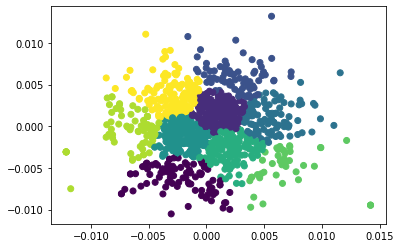

In [ ]:
# Plot the reduced vectors with different colors for each cluster
plt.scatter(reduced_sentence_embeddings_D2V[:, 0], reduced_sentence_embeddings_D2V[:, 1], c=kmeans.labels_)
plt.show()

In [ ]:
df7['cluster_D2V'] = kmeans.predict(reduced_sentence_embeddings_D2V)

### Sentence which are similar to first sentence

In [ ]:
print(df7['text'][0])
print(0)
vec1 = sentence_vectors_D2V[x].reshape(1, -1)
for i in range(len(df7)):
  vec2 = sentence_vectors_D2V[i].reshape(1, -1)
  similarity=cosine_similarity(vec1,vec2)
  if similarity>=0.3:
    print(df7['text'][i])
    print(similarity)
    print(i)

get discount food
0
get discount food
[[1.]]
0
much point
[[0.3701695]]
826
much point
[[0.37014908]]
827


In [ ]:
df7

,_id,text,direction,type,createdAt,sentiment,vectors_TF,cluster_TF,tokens_word,vectors_W2V,cluster_W2V,vectors_USE,cluster_USE,vectors_BERT,cluster_BERT,tokens_sent,vectors_D2V,cluster_D2V
0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[get, discount, food]","[[0.004462765, 0.00089486025, 0.001281267, 0.0...",0,-0.019439,6,-0.522000,7,[get discount food],"[0.0032840867, 0.00061079144, 0.0038164863, 0....",4
1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[non, veg, buffet, price, member]","[[0.005131776, -0.004905238, -0.0015936384, 0....",4,0.034923,6,-0.155360,5,[non veg buffet price member],"[0.0022413556, -0.0011644731, -0.0010507435, -...",0
2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[make, reserv, bill, bill, present, digit, pai...","[[-0.000308945, 0.0033469624, -0.0046594264, -...",5,-0.066831,6,-0.761719,7,[make reserv bill bill present digit paid cash],"[0.0037744003, -0.00139832, 0.00393199, -0.004...",5
3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,negative,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],0,"[sorri, book, mistak]","[[0.0019674986, 0.0011526848, -0.0016646305, 0...",3,0.005782,1,-0.527465,4,[sorri book mistak],"[0.002654203, -0.0011347278, 0.0017583711, 0.0...",1
4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,positive,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[much, buffet, per, person]","[[0.00031941914, -0.00030237, 0.0012645756, 0....",5,-0.064287,6,-0.297931,0,[much buffet per person],"[-0.0043887035, 0.0042240554, 0.0027476358, 0....",8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
992,ObjectId(61559ce8bb65255631310554),arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:18:00.112Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[arrang, surpris, birthday]","[[0.0021385285, 0.0024560557, -0.001455537, 0....",2,-0.087437,0,-0.481709,0,[arrang surpris birthday],"[-0.0016839535, -0.0037185461, 0.0049365894, 0...",3
993,ObjectId(61559e50bb65255631310558),u arrang surpris birthday,INBOUND,TEXT,2021-09-30T11:24:00.350Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[u, arrang, surpris, birthday]","[[-0.0013370005, 0.0015429106, 0.00010546608, ...",1,-0.080673,0,-0.360373,0,[u arrang surpris birthday],"[-0.004849076, 0.00043521856, 0.0020884953, 0....",6
994,ObjectId(6155a219bb6525563131056a),hello dress code punjab grill pleas men wear s...,INBOUND,TEXT,2021-09-30T11:40:09.158Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],4,"[hello, dress, code, punjab, grill, pleas, men...","[[0.00028019585, -0.00057927635, -0.0034817406...",1,0.031258,0,1.011950,7,[hello dress code punjab grill pleas men wear ...,"[0.0022725624, -0.0013027424, -0.0017168331, -...",5
995,ObjectId(6155a263bb65255631310572),see time paid bill upload herewith,INBOUND,TEXT,2021-09-30T11:41:23.966Z,neutral,[[[[[0. 0. 0. ... 0. 0. 0.]]]]],2,"[see, time, paid, bill, upload, herewith]","[[-0.0018154272, -0.0022914498, 0.0012173563, ...",4,0.001567,0,-0.096249,0,[see time paid bill upload herewith],"[0.0016797476, -0.004645516, -0.0024410374, -0...",2


## Clusters

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df7.groupby('cluster_D2V').size()
print(result)

cluster_D2V
0     89
1    175
2     74
3     93
4    170
5    133
6     41
7     74
8    148
dtype: int64


### Cluster : 0

In [ ]:
print(df7[df7['cluster_D2V']==0]['text'])

1                            non veg buffet price member
43                                         cancel reserv
44                                     cancel websit app
59                                            gave offer
63                                  would tht later date
                             ...                        
882    remind book ab absolut barbecu diner pm book i...
895    good even l visit gilli nd month thank regard ...
896    good even l visit gilli nd month thank regard ...
898             book pm friday saturday sunday even wait
958    pl book keylin experi aeroc pm today instead book
Name: text, Length: 89, dtype: object


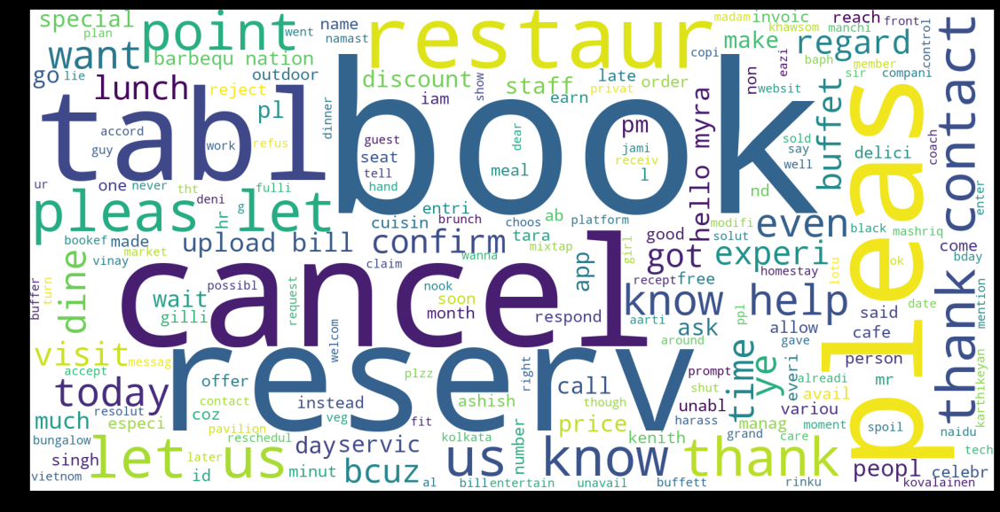

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==0]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df7[df7['cluster_D2V']==1]['text'])

3                                      sorri book mistak
5      payment alert spent rs credit card xx radisson...
6                                          complain help
14                  alreadi chat concern alreadi address
25          tell exactli much bill expect book today nyc
                             ...                        
966    hello myra select number guest soon confirm re...
968           rhink u read messag confirm declin restaur
972             cancel book number barbequ nation oct pm
975                            possibl chang reserv time
989                           get book person today even
Name: text, Length: 175, dtype: object


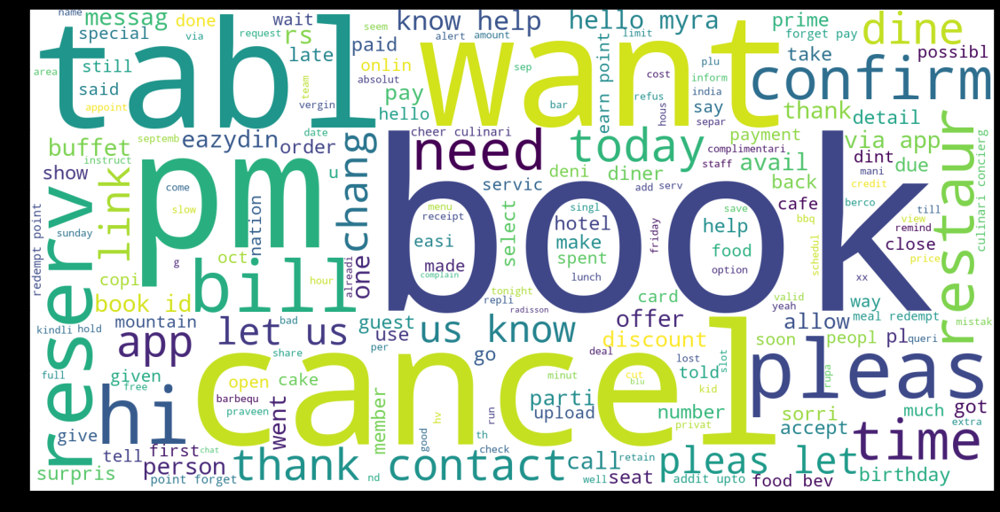

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==1]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df7[df7['cluster_D2V']==2]['text'])

7                            bill current go reserv time
19                             dine unfortun bill anymor
35                                serv alcohol also asha
39                                hi want cancel book pl
42                                              get back
                             ...                        
911    hello myra book peopl come gurgaon traffic roa...
926                             hi dine left bill amount
951                           reserv tabl window balconi
965                           put paytm code avail offer
995                   see time paid bill upload herewith
Name: text, Length: 74, dtype: object


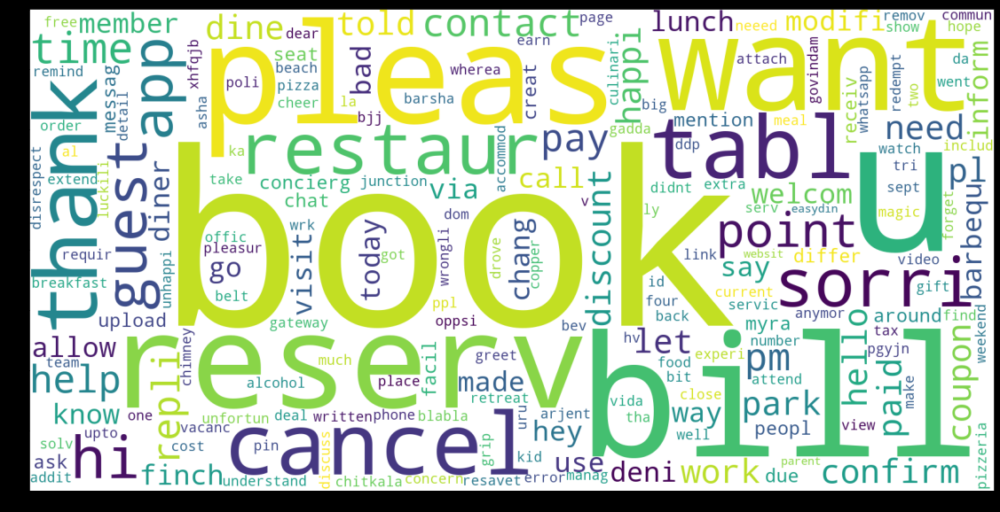

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==2]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df7[df7['cluster_D2V']==3]['text'])

20                                              abl make
21                               would wish cancel tiqri
29                              way might get littl late
46                                          hi rebook pm
68     hello myra got difficulti pay bill easi dine g...
                             ...                        
944                   pleas ask staff call back tomorrow
961                                 hi help chang reserv
971                                          know cancel
980                          show pm reserv time account
992                              arrang surpris birthday
Name: text, Length: 93, dtype: object


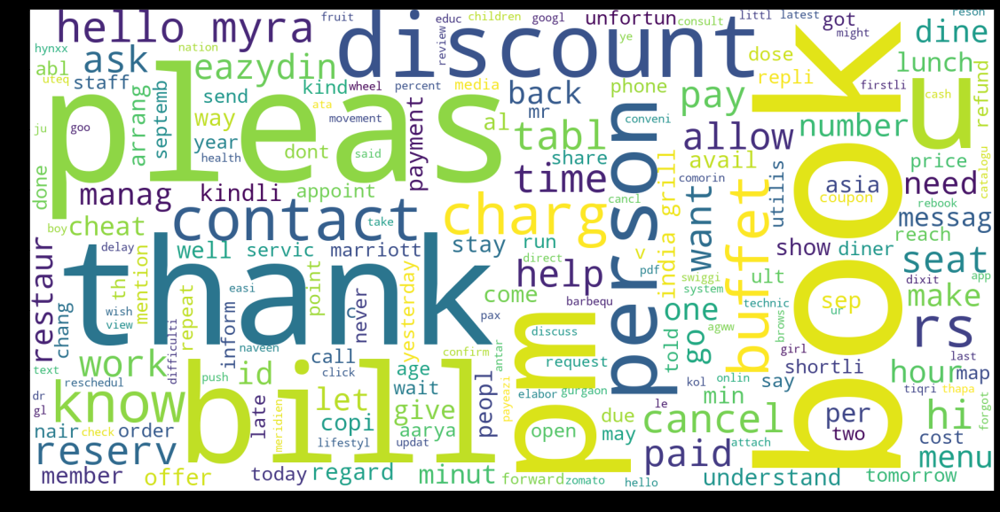

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==3]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df7[df7['cluster_D2V']==4]['text'])

0                                      get discount food
15                                                   min
53                                             meant pax
55     dear guest finest greet thank messag unavail r...
80                                            pay advanc
                             ...                        
978                             make reserv misplac bill
979           hi trust dinner reserv confirm speak hotel
985                            sorri pleas cancel reserv
991    increas instagram follow peopl requir requir t...
996                                     restaur page app
Name: text, Length: 170, dtype: object


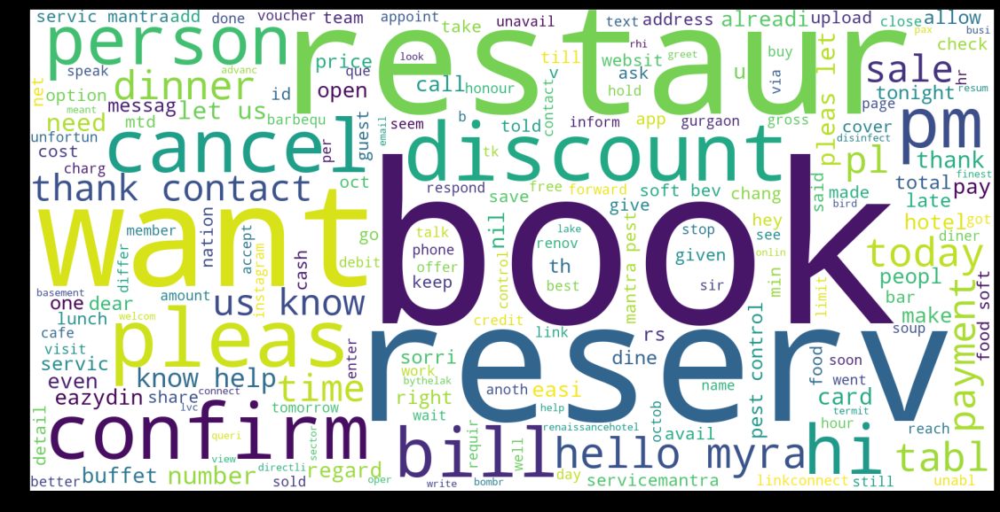

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==4]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df7[df7['cluster_D2V']==5]['text'])

2          make reserv bill bill present digit paid cash
11     thank contact kanak interior pleas let us know...
17      thank contact benz packag pleas let us know help
24                   visit cancel plan proper sit arrang
27                                        get drink menu
                             ...                        
976                                        book saturday
982                                   mistak cancel book
987    tata group th anniversari celebr click link pa...
990           barbecu nation would like book today guest
994    hello dress code punjab grill pleas men wear s...
Name: text, Length: 133, dtype: object


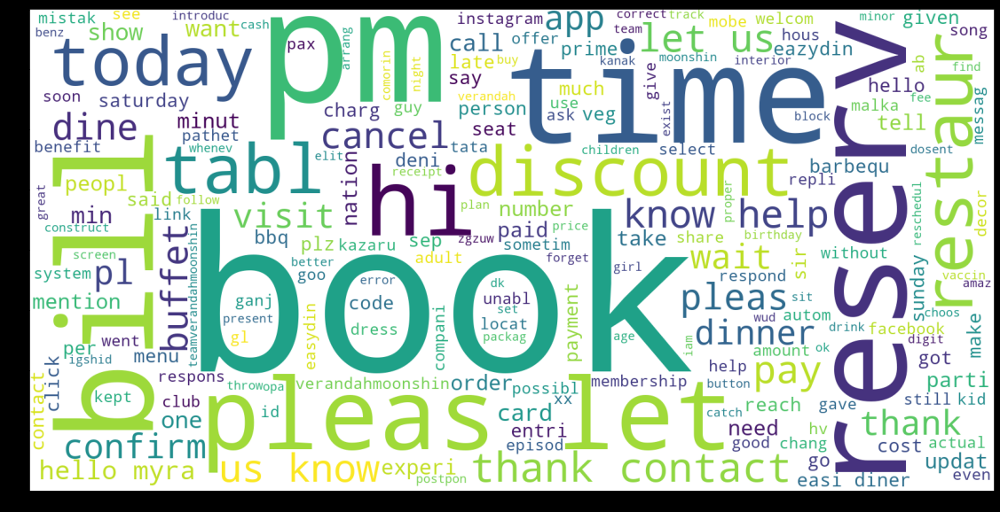

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==5]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 6

In [ ]:
print(df7[df7['cluster_D2V']==6]['text'])

9                                   exactli price person
23       thank messag unavail right respond soon possibl
56     dear guest thank messag queri import us howev ...
65      nt dine daddi restaur proper respons manag staff
70                                   much long tabl held
111                                    cad cocktail menu
148    thank contact tutsin websit design digit marke...
160      thank messag unavail right respond soon possibl
173                                                hi pm
193    thank contact cut n sew fashion pleas let us k...
226            want confirm show book messag enter right
257      hey dine dont bill anymor tell order least gist
266                                    sorri make dinner
304                                   price dinner plate
306                             forgot use app take bill
322                 pleas cancel book due emerg abl make
326    hello book talli turmer worli pm run late pl i...
328                  want buffe

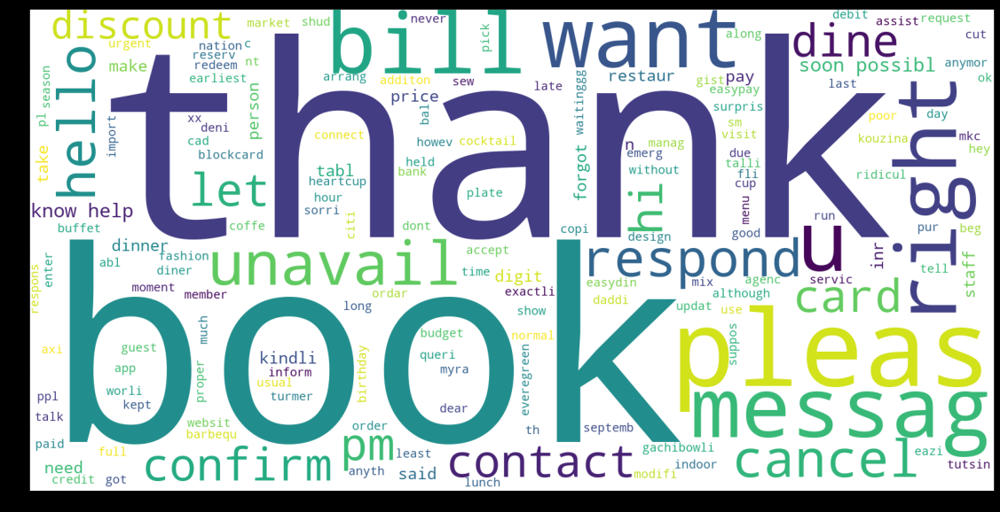

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df7[df7['cluster_D2V']==6]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# Topic Modeling

# 6) BERTopic

In [ ]:
!pip install bertopic
clear_output()

In [ ]:
!pip install bertopic[visualization] --quiet
clear_output()

In [ ]:
import numpy as np
import pandas as pd
from copy import deepcopy
from bertopic import BERTopic

In [ ]:
path='/content/drive/MyDrive/Copy of Copy of processed_messages_20.csv'

In [ ]:
df99 = pd.read_csv(path)

In [ ]:
docs = list(df99.loc[:, "text"].values)

In [ ]:
docs[:5]

['get discount food',
 'non veg buffet price member',
 'make reserv bill bill present digit paid cash',
 'sorri book mistak',
 'much buffet per person']

## **Creating Topics**

In [ ]:
topic_model = BERTopic(nr_topics=20,embedding_model="all-MiniLM-L6-v2")

In [ ]:
topics, probs = topic_model.fit_transform(docs)
clear_output()

## We can then extract most frequent topics:

In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,47639,-1_thank_contact_pleas_us
1,0,2727,0_tabl_peopl_book_mistak
2,1,2663,1_price_cost_buffet_lunch
3,2,2660,2_eazydin_confirm_deal_extra
4,3,2329,3_discount_sale_mtd_bill
5,4,1818,4_chang_time_pm_slot
6,5,1699,5_traffic_reach_late_waitlist
7,6,1659,6_cancel_book_kindli_id
8,7,1619,7_payment_payeazi_pay_via
9,8,1519,8_card_spent_rs_inr


## Get Individual Topics

In [ ]:
topic_model.get_topic(0)

[('tabl', 0.12602741478699497),
 ('peopl', 0.10032302247653982),
 ('book', 0.10019677388373703),
 ('mistak', 0.07862488218496633),
 ('reserv', 0.07751889432937362),
 ('pm', 0.07350195147510802),
 ('want', 0.053432890032054085),
 ('sold', 0.04598529522665457),
 ('need', 0.0450057878010114),
 ('privat', 0.03530400857283758)]

In [ ]:
df100 = pd.DataFrame({'topic': topics, 'document': docs})
df100.loc[df100["topic"] == 5]

,topic,document
15,5,min
29,5,way might get littl late
36,5,block reach minut
45,5,say min wait
128,5,take min reach
...,...,...
76716,5,say waitlist
76797,5,book tabl intim restaur
76818,5,pleas remov broad cast list
76862,5,tri reach delhi time seem difficult sinc due r...


## **Visualize Topics**

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart()

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=20, random_state=0)
kmeans.fit(probs.reshape(-1,1))

KMeans(n_clusters=20, random_state=0)

In [ ]:
cluster_labels = kmeans.predict(probs.reshape(-1,1))

In [ ]:
df100['Topic_BERT'] = cluster_labels

## Clusters

In [ ]:
df100[df100['Topic_BERT']==0]['document']

0                                        get discount food
1                              non veg buffet price member
5        payment alert spent rs credit card xx radisson...
12                                  may know non veg price
13       hi eazydin prime member save everi time eat pl...
                               ...                        
77092    thank contact shree nandha oil mill pleas let ...
77095    send good porter intra citi logist marketplac ...
77096         land line internet work tripunithura tri fix
77102                                    make reserv peopl
77108                        despit membership servic crap
Name: document, Length: 18313, dtype: object

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df100.groupby('Topic_BERT').size()
print(result)

Topic_BERT
0     18313
1      1261
2      1760
3      1742
4      1715
5      1964
6     27386
7      1707
8      1910
9      1756
10     1699
11     1802
12     1859
13     1777
14     1800
15     1835
16     1742
17     1763
18     1583
19     1738
dtype: int64


### Cluster : 0

In [ ]:
print(df100[df100['Topic_BERT']==0]['document'])

0                                        get discount food
1                              non veg buffet price member
5        payment alert spent rs credit card xx radisson...
12                                  may know non veg price
13       hi eazydin prime member save everi time eat pl...
                               ...                        
77092    thank contact shree nandha oil mill pleas let ...
77095    send good porter intra citi logist marketplac ...
77096         land line internet work tripunithura tri fix
77102                                    make reserv peopl
77108                        despit membership servic crap
Name: document, Length: 18313, dtype: object


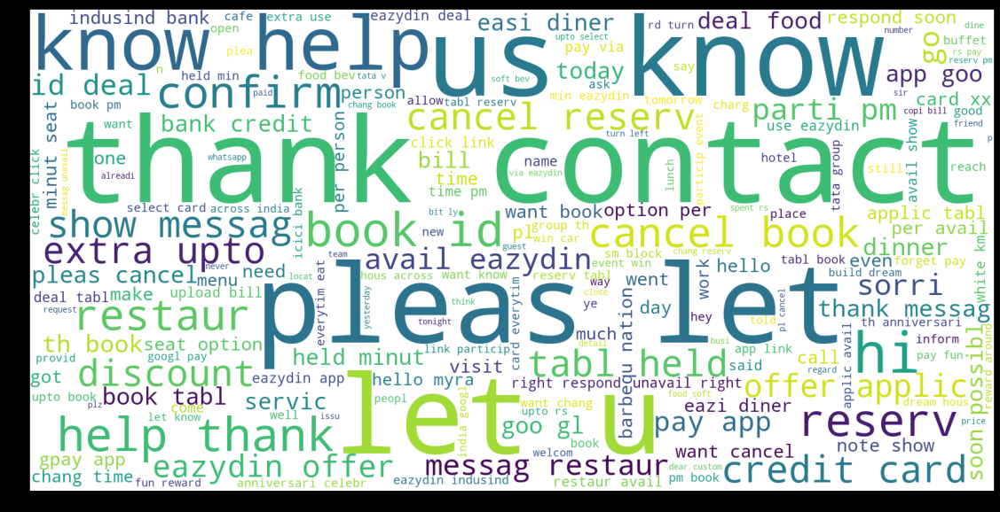

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==0]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df100[df100['Topic_BERT']==1]['document'])

43                                           cancel reserv
67                                            avail moment
93                hi option cancel reserv someth came line
132                              u guy make custom fullish
213                                               revis pm
                               ...                        
76518                             found technic error site
76535            thank contact love pleas let us know help
76730            realli sorri say treat seper book eazydin
76976    build dream hous across india googl pay fun re...
77072    build dream hous across india googl pay fun re...
Name: document, Length: 1261, dtype: object


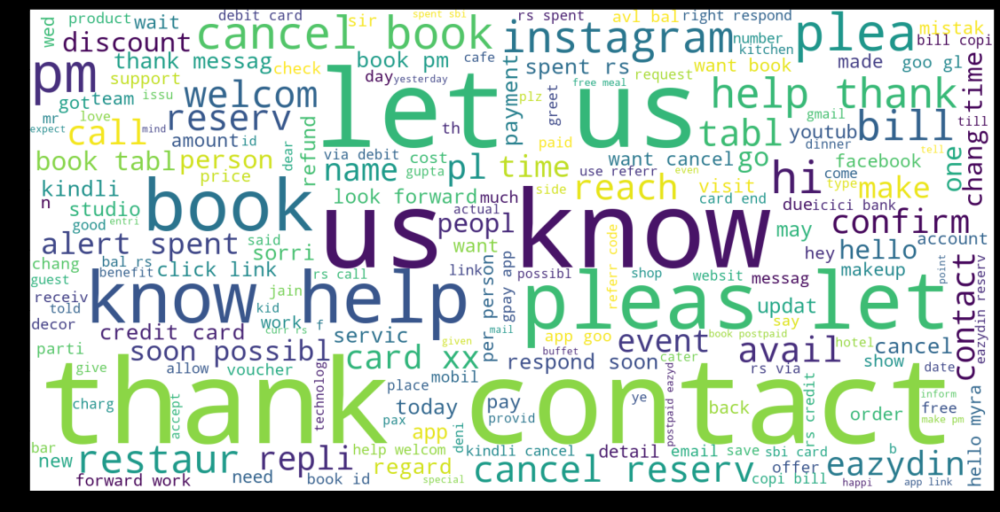

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==1]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df100[df100['Topic_BERT']==2]['document'])

61                                      hi updat book time
108      give good deal dinner buffet raddisson blu kau...
145                          abhi tak servic start nhi hui
189                                            cake arrang
196      r vegetarian want limit option alreadi limit o...
                               ...                        
76731              thank fool embarass restro book eazydin
76841    thank contact shaw super mart pleas let us kno...
76871                   hello myra guy serv hookah restaur
76924    thank contact shubham jain pleas let us know help
77033    hey came across cafe especi love friendli auth...
Name: document, Length: 1760, dtype: object


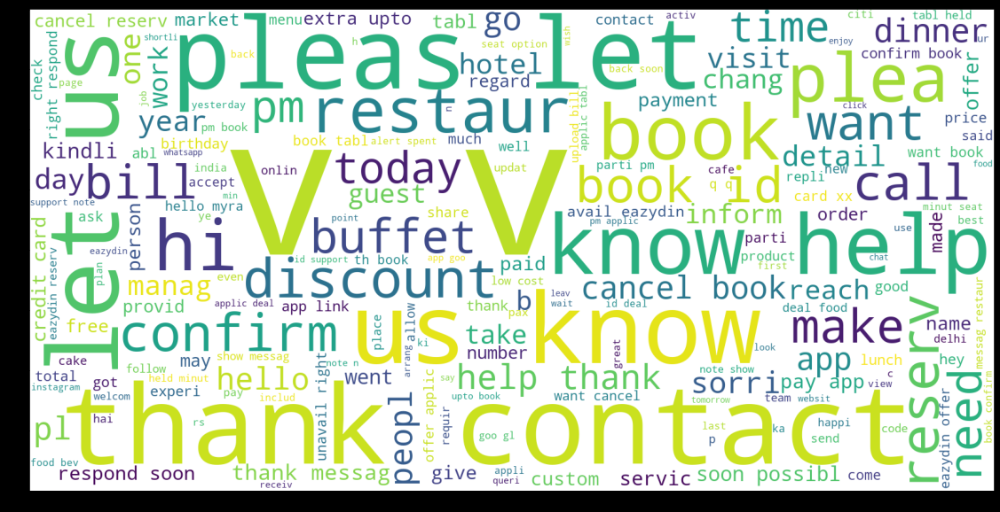

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==2]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df100[df100['Topic_BERT']==3]['document'])

14                    alreadi chat concern alreadi address
105      thank contact aditya mathur pleas let us know ...
204                                want chang parti member
207                    pleas reschedul book peopl pm today
277                                 park eas church street
                               ...                        
76916                        ok issu part american express
76947                              zero balanc right babii
77001    thank contact pv ramdev everest engin equip pv...
77065                          want know price bbq compani
77074    good morn yamini garu hari babai manoz teja co...
Name: document, Length: 1742, dtype: object


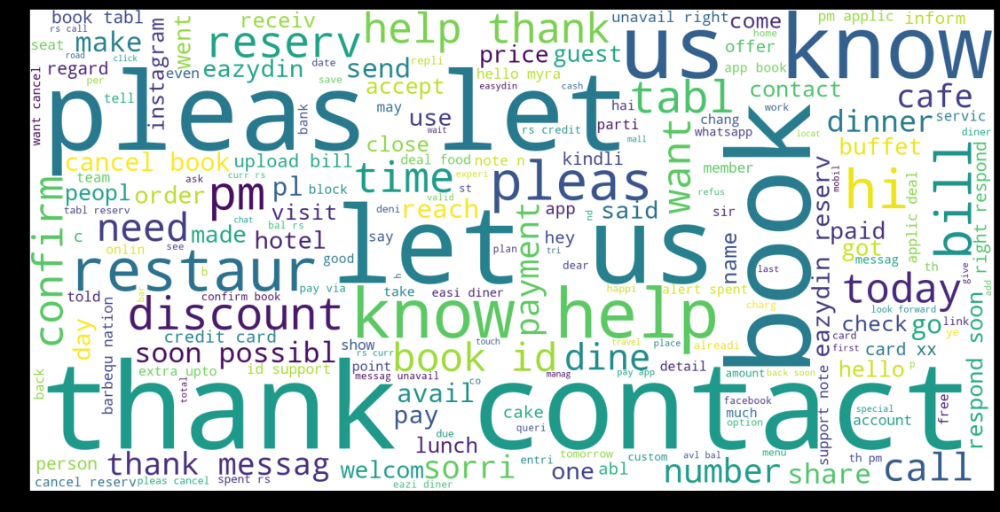

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==3]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df100[df100['Topic_BERT']==4]['document'])

180      hi mayank reserv molecul air bar confirm green...
234                                         seat full seem
419                                       need cancel book
449                                     serv cake birthday
484                                hi book nd octob onward
                               ...                        
76837                      access addit discount hdfc card
76878                       add one person parti friday th
76881    fun build hous goa join indi home http gpay ap...
76882                                         hi reserv pm
77085                                   want cancel reserv
Name: document, Length: 1715, dtype: object


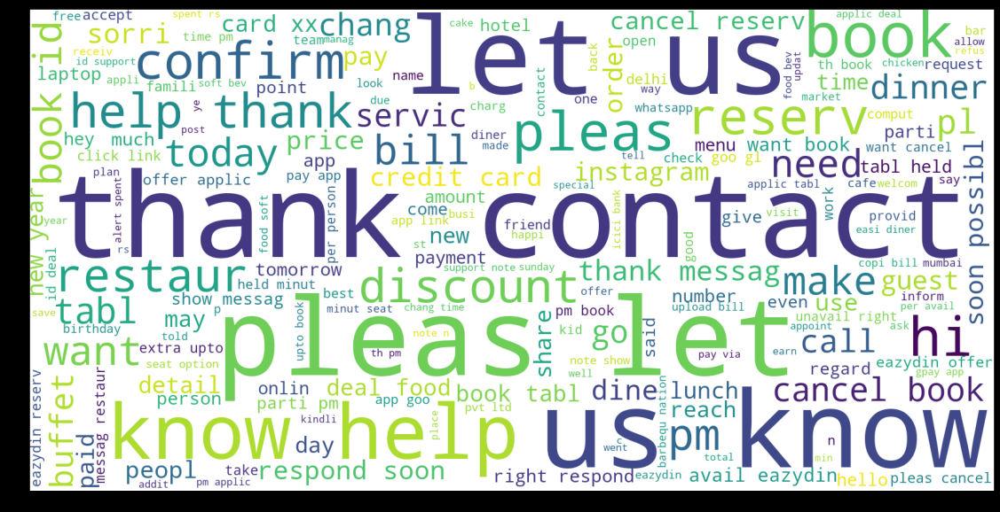

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==4]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df100[df100['Topic_BERT']==5]['document'])

48                                           receipt share
110                             entri fee parti night girl
227                             want make reserv peopl wat
289                              hello myra wait even book
294      thank contact kazaru decor space us uniqu anti...
                               ...                        
76891    fun build hous manipur join indi home http gpa...
76908                         mr jeric hotel reserv sachin
76994                               team member select sir
77040                                   u extend book time
77062                        deni pay bill use eazydin app
Name: document, Length: 1964, dtype: object


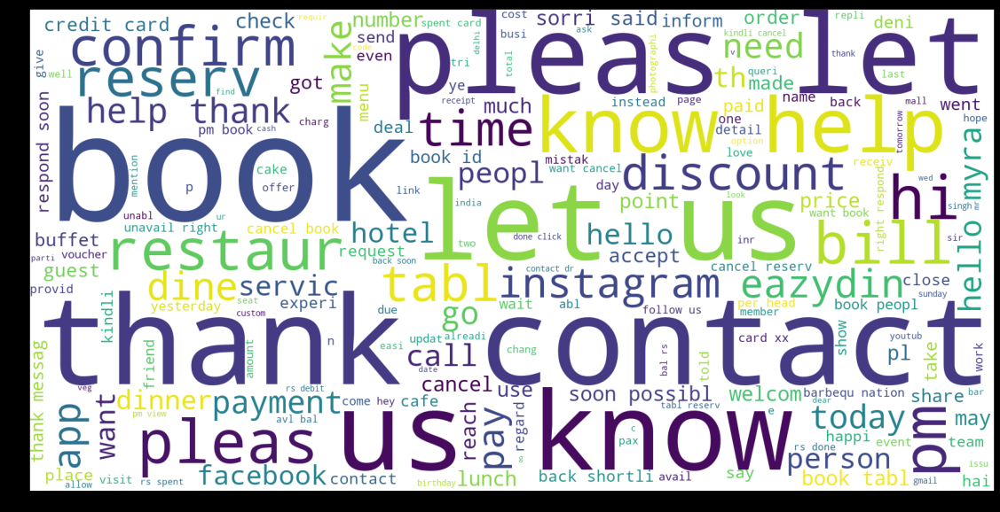

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==5]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

Cluster : 6

In [ ]:
print(df100[df100['Topic_BERT']==6]['document'])

3                                        sorri book mistak
4                                   much buffet per person
7                              bill current go reserv time
16                                       charg advanc book
17        thank contact benz packag pleas let us know help
                               ...                        
77105    gather guru present halli h r tsava date place...
77107    januari thangavel sp depart fashion technolog ...
77109    pleas give deal today burma burma sector noida...
77110     thank messag respond pleas call thank understand
77111    thank messag get back soon kindli pleas call r...
Name: document, Length: 27386, dtype: object


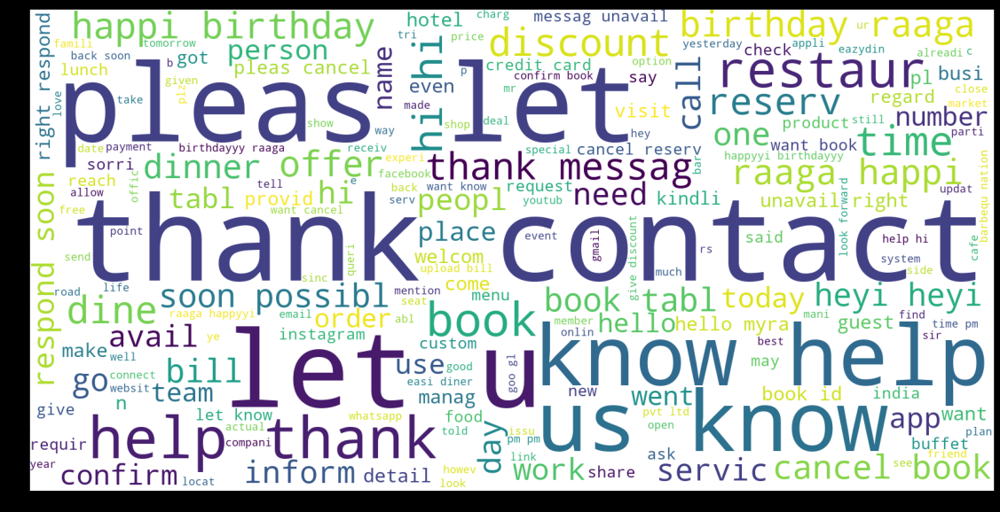

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df100[df100['Topic_BERT']==6]['document'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

# 7) Top2Vec

In [ ]:
# # !pip install top2vec
# !pip install top2vec==1.0.6
# clear_output()

In [ ]:
# from top2vec import Top2Vec

In [ ]:
# !pip install top2vec[sentence_transformers]
# clear_output()

In [ ]:
# !pip install -q tensorflow
# !pip install -q tensorflow_hub
# !pip install -q tensorflow_text
# clear_output()

In [ ]:
# !pip install top2vec[sentence_encoders]
# # !pip install tensorflow tensorflow_hub tensorflow_text
# clear_output()

In [ ]:
# documents = df99['text'].values.tolist()

In [ ]:
# sentence=documents[:1000]
# len(sentence)

In [ ]:
# model_reviews = Top2Vec(documents=document)

In [ ]:
# model_reviews.get_num_topics()

In [ ]:
# #model = Top2Vec(docs, embedding_model='universal-sentence-encoder')
# # model = Top2Vec(df99['text'].values, embedding_model='universal-sentence-encoder')
# model= Top2Vec(docs)
# clear_output()

In [ ]:
# top2vec = Top2Vec(documents=docs, speed="learn", workers=4)

In [ ]:
# topic_sizes, topic_num=model_reviews.get_topic_sizes()

In [ ]:
# print(topic_sizes)

In [ ]:
# topic_words, topic_scores, topic_nums = model.get_topics(10)

# 8) LDA

In [ ]:
import pandas as pd
from gensim.corpora import Dictionary
from gensim.models import LdaModel
from gensim.matutils import sparse2full


sentences = df99["text"].apply(lambda x: x.split())

# Vectorize the text
dictionary = Dictionary(sentences)
bow_corpus = [dictionary.doc2bow(sentence) for sentence in sentences]

# Fit the LDA model
lda_model = LdaModel(bow_corpus, num_topics=10, id2word=dictionary)

# Extract topics
topics = lda_model.show_topics(num_words=10, formatted=False)


In [ ]:

# Assign topics to sentences
def get_topic(bow):
    topic, _ = max(lda_model[bow], key=lambda x: x[1])
    return topic

df99["Topic_LDA"] = [get_topic(dictionary.doc2bow(sentence)) for sentence in sentences]


In [ ]:
df99

,Unnamed: 0,_id,text,direction,type,createdAt,topic,Topic_LDA
0,0,ObjectId(614c4ff1bb6525563130cec9),get discount food,INBOUND,TEXT,2021-09-23T09:59:13.297Z,9,9
1,1,ObjectId(614c502dbb6525563130cecb),non veg buffet price member,INBOUND,TEXT,2021-09-23T10:00:13.683Z,2,2
2,2,ObjectId(614c5081bb6525563130ced6),make reserv bill bill present digit paid cash,INBOUND,TEXT,2021-09-23T10:01:37.314Z,1,1
3,3,ObjectId(614c5139bb6525563130cee2),sorri book mistak,INBOUND,TEXT,2021-09-23T10:04:41.898Z,6,6
4,4,ObjectId(614c544bbb6525563130ceef),much buffet per person,INBOUND,TEXT,2021-09-23T10:17:47.868Z,6,6
...,...,...,...,...,...,...,...,...
77107,77527,ObjectId(63be6807a51a3e6365f88689),januari thangavel sp depart fashion technolog ...,INBOUND,TEXT,2023-01-11T07:40:55.629Z,2,2
77108,77528,ObjectId(63be6992a51a3e6365f88696),despit membership servic crap,INBOUND,TEXT,2023-01-11T07:47:30.546Z,8,8
77109,77529,ObjectId(63be69e0a51a3e6365f8869a),pleas give deal today burma burma sector noida...,INBOUND,TEXT,2023-01-11T07:48:48.704Z,6,6
77110,77530,ObjectId(63be6c1aa51a3e6365f886a8),thank messag respond pleas call thank understand,INBOUND,TEXT,2023-01-11T07:58:18.412Z,8,8


In [ ]:
!pip install pyLDAvis==3.2.1
clear_output()

In [ ]:
import pyLDAvis
import pyLDAvis.gensim

pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, bow_corpus, dictionary)
pyLDAvis.display(vis)


/usr/local/lib/python3.8/dist-packages/past/types/oldstr.py:5: DeprecationWarning:

Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.10 it will stop working



## Clusters

In [ ]:
# Group the dataframe by the 'region' column and use the size() method to get the count of rows
result = df99.groupby('Topic_LDA').size()
print(result)

Topic_LDA
0     2386
1    10082
2     4180
3    13609
4     5775
5     8691
6    17261
7     3382
8     6166
9     5580
dtype: int64


###  Cluster : 0

In [ ]:
print(df99[df99['Topic_LDA']==0]['text'])

27                                          get drink menu
40                     whenev click pay button throw error
47                                                  dine k
79                                          want gift deal
93                hi option cancel reserv someth came line
                               ...                        
76998    thank contact deepak h v wholesal distributor ...
77019    persepoli veil symbol oppress regim islam repu...
77048                                 get percent discount
77060                                  ye money honey babi
77064             en kuda yen msg pannura nalaiku paakalam
Name: text, Length: 2386, dtype: object


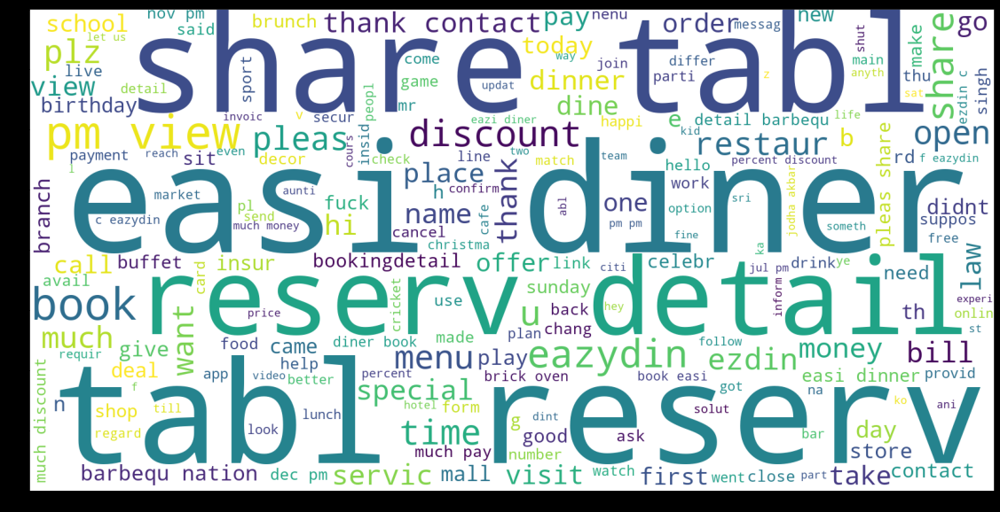

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==0]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 1

In [ ]:
print(df99[df99['Topic_LDA']==1]['text'])

2            make reserv bill bill present digit paid cash
14                    alreadi chat concern alreadi address
18                                           account block
19                               dine unfortun bill anymor
26                                 tell bill amount advanc
                               ...                        
77078                      restaur accept payment easi pay
77080    build dream hous across india googl pay fun re...
77089                 hi would like know credit card enabl
77091                                      easydin app pay
77106        need talk eazydin execut pleas contact number
Name: text, Length: 10082, dtype: object


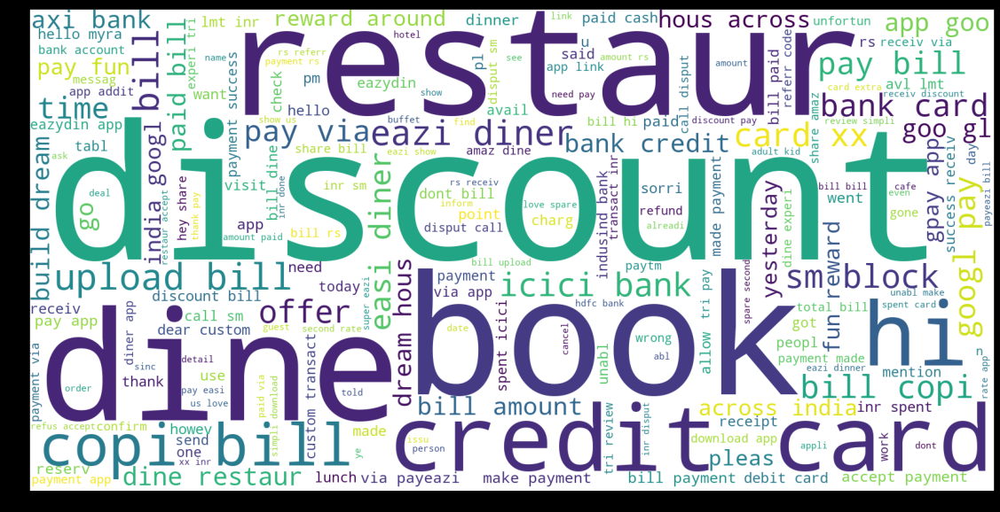

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==1]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 2

In [ ]:
print(df99[df99['Topic_LDA']==2]['text'])

1                              non veg buffet price member
51                                 ye dinner jungl jambore
53                                               meant pax
69                                     book one day beforw
134      check review barbequ nation googl map http goo...
                               ...                        
77097    hey join airtel prepaid today use invit link b...
77098    pm jillqueen love friend famili pleas help pro...
77101    think posit thing go wrong first reaction fear...
77105    gather guru present halli h r tsava date place...
77107    januari thangavel sp depart fashion technolog ...
Name: text, Length: 4180, dtype: object


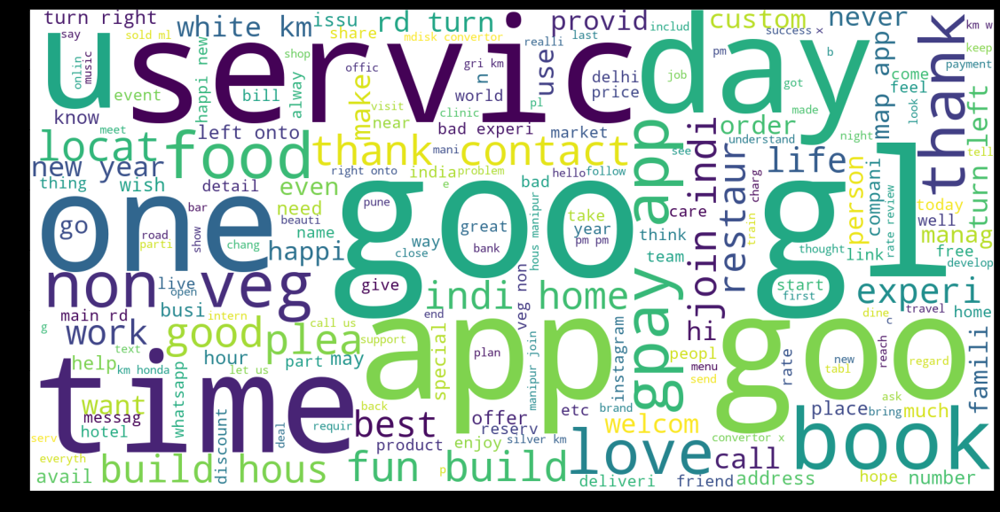

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==2]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 3

In [ ]:
print(df99[df99['Topic_LDA']==3]['text'])

6                                            complain help
11       thank contact kanak interior pleas let us know...
12                                  may know non veg price
17        thank contact benz packag pleas let us know help
22                    thank contact pleas let us know help
                               ...                        
77079    thank contact rupali bhushan pleas let us know...
77083    thank contact us case someth import urgent ple...
77088    dear sir madam greet modern tourism thank cont...
77092    thank contact shree nandha oil mill pleas let ...
77094        thank contact kbhumesh pleas let us know help
Name: text, Length: 13609, dtype: object


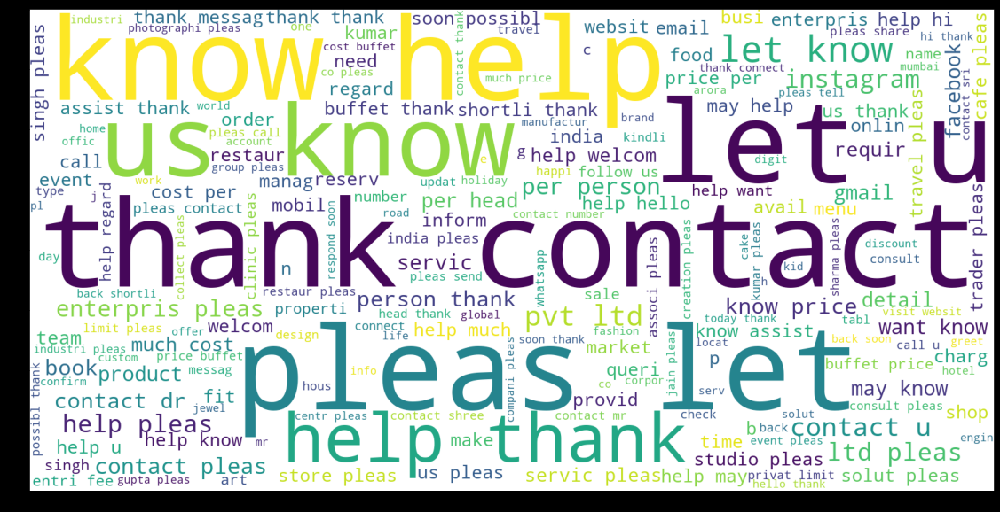

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==3]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 4

In [ ]:
print(df99[df99['Topic_LDA']==4]['text'])

7                              bill current go reserv time
8                                            said tie dine
20                                                abl make
24                     visit cancel plan proper sit arrang
63                                    would tht later date
                               ...                        
77057    saal kitni der lagaega bohot lga liya time ab ...
77059    teen din wednesday thursday friday paper trade...
77063                     clg pasanga kuda pesura yar avan
77086    think like profil see match http bum bb u vxj ...
77087    bataan ki baat toh nahi hai par bataan dogi ky...
Name: text, Length: 5775, dtype: object


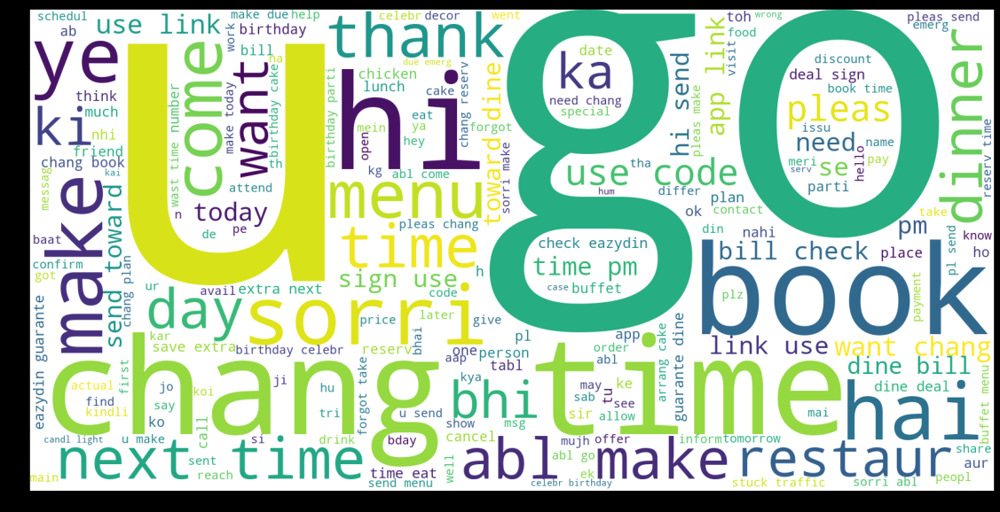

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==4]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

### Cluster : 5

In [ ]:
print(df99[df99['Topic_LDA']==5]['text'])

16                                       charg advanc book
29                                way might get littl late
35                                  serv alcohol also asha
45                                            say min wait
59                                              gave offer
                               ...                        
76974       know ur compani polici think u r reimburs fund
76980    give foot massag person right say someth dirti...
76993    anudeep kumar p r jeeven gowda chandrshekar ni...
77011                       restaur offer discount weekend
77041                                      run late famili
Name: text, Length: 8691, dtype: object


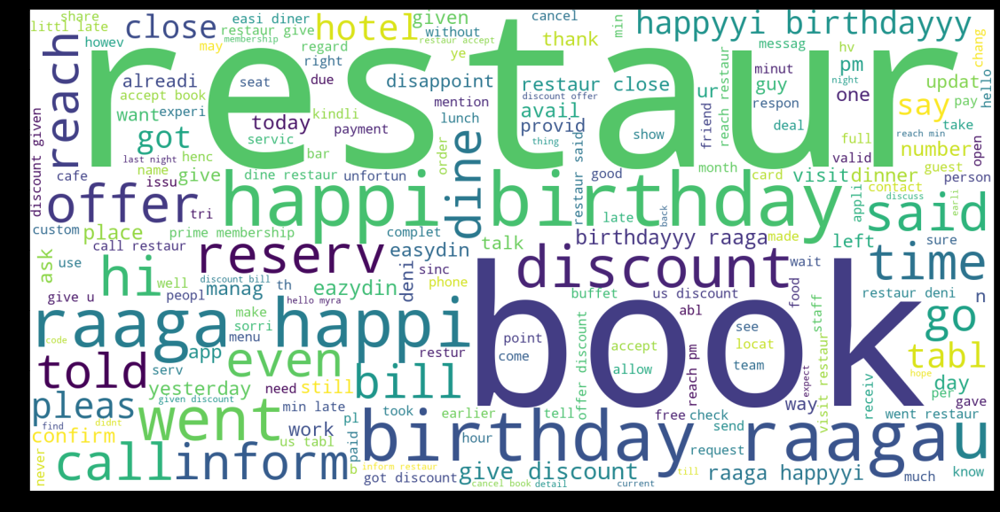

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==5]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()

Cluster : 6

In [ ]:
print(df99[df99['Topic_LDA']==6]['text'])

3                                        sorri book mistak
4                                   much buffet per person
9                                     exactli price person
10                                        want cancel book
21                                 would wish cancel tiqri
                               ...                        
77085                                   want cancel reserv
77093                                need rider pick order
77102                                    make reserv peopl
77104                          hi need talk eazydin execut
77109    pleas give deal today burma burma sector noida...
Name: text, Length: 17261, dtype: object


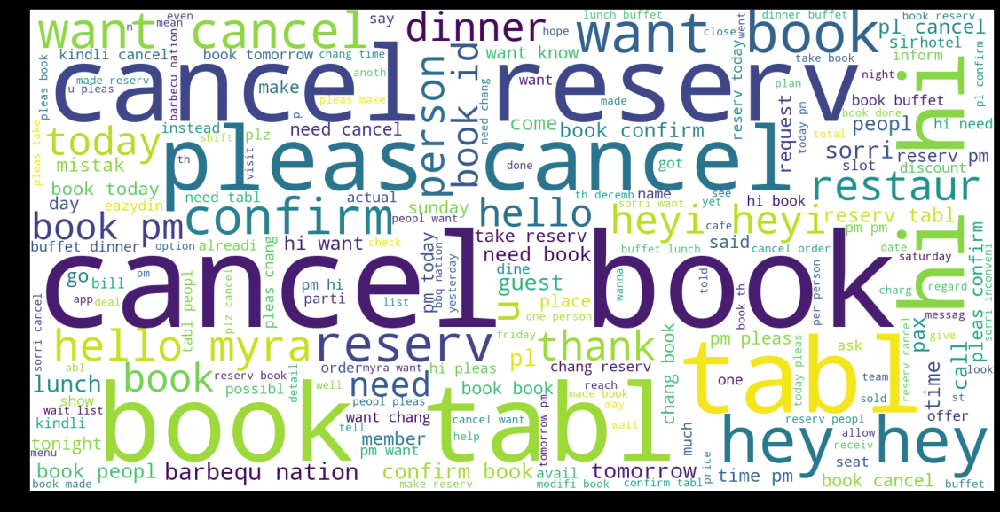

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
wordcloud = WordCloud(background_color="white",width=1600, height=800).generate(' '.join(df99[df99['Topic_LDA']==6]['text'].tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
clear_output()